## (3) Practice Learning Activity: Transform data for modeling using a data integration tool
##### (GenAI Life Cycle Phase 3: Data Preparation self-practice)

#### **Case Scenario:** 
>
> With your exploratory data analysis (EDA) from Activity 2 complete, CoffeePro now requires the transformation of the analyzed data into a format suitable for RAG. Management envisions an AI-powered virtual agent capable of personalized coffee recommendations and expert guidance, and this step is critical in ensuring the data is usable for this purpose.
>
> Your role as an AI developer is to utilize Apache Hop to integrate and preprocess the datasets. This includes transforming both the SQL Product Database and the compiled CSV file of online resources into a unified format that is ready for Retrieval Augmented Generation (RAG). The goal is to generate a structured dataset that captures critical features such as coffee bean attributes, recommended brewing methods, and guidance on preparation techniques while ensuring compatibility with the case's requirements.
>
> The transformation must prepare the data to include essential details such as:
>
> Coffee bean characteristics (e.g., roast degree, flavor profiles, origin).
> Brewing method details (e.g., techniques, tools, and preparation steps).
> Any additional insights from the CSV resource file (e.g., barista tips, video descriptions, or article excerpts).
> Management has specifically requested the output to include clear labels, a consistent structure, and compatibility with common file formats used for LLM training (i.e A spreadsheet). 
>
> Your tasks are as follows:
>
>(a) Identify the file type and format (or shape) that the data will be transformed into. 
>
>(b) Use Apache Hop to transform data into a shape and file type suitable for RAG.
>
> By completing these tasks you will develop hands-on expertise on using Apache Hop for data integration, organization, and labeling, preparing datasets for RAG and otherwise building effective AI applications.

---

### Pre-requisites: 
- [Ensure MySQL is running](../learning-files/ailtk-mysql-howto.ipynb).

#### (a) Identify the file type and format (or shape) that the data will be transformed into.

*What file output type can we use to implement RAG later on? What columns must it contain?*

In [2]:
import ipywidgets as widgets
from IPython.display import display, HTML

# Create input text box
input_box = widgets.Textarea(
    placeholder='Type your answer here...',
    description='Answer:',
    layout=widgets.Layout(width='400px')
)

# Create button
submit_button = widgets.Button(
    description="Submit",
    button_style='primary',  # Optional: styling
)

# Create output widget
output = widgets.Output()

# Define the button click event
def on_submit_click(b):
    # Clear previous output
    output.clear_output()
    
    # Access the input text and generate an answer
    question = input_box.value
    answer = """
    We were provided with data from two different sources: a MySQL database and a CSV file. 
    Both of these data sources revolve around products and their other related information.
    Given this, we can start by having the products' names in an "input" column and
    the other information about them in an "output" column. By using Apache Hop, we will come 
    up with a merged dataset in a spreadsheet file format. Spreadsheets are a versatile 
    that we will use later on in our RAG implementation as our "corpus" or body of specific
    information for the virtual agent to use later on.
    """
    
    # Display the answer as HTML in the output widget
    with output:
        display(HTML(answer))

# Set the button's on-click function
submit_button.on_click(on_submit_click)

# Display the widgets
display(input_box, submit_button, output)


Textarea(value='', description='Answer:', layout=Layout(width='400px'), placeholder='Type your answer here...'…

Button(button_style='primary', description='Submit', style=ButtonStyle())

Output()

- In the context of building virtual agents, this data transformation primarily involves manipulating raw documents and data (or in other words, information from various source) into a usable format. This can include extracting text, tables, and images from a collection of PDFs and putting them into a **"corpus,"** which is a general term for a structured repository of knowledge that the virtual agent can access and use for generating accurate, context-aware responses. A spreadsheet will serve as our corpus in this example. In the next part of this activity, we will be seeing how we can transform the company's existing data into a corpus that our virtual agent will use later on. 

#### (b) Use Apache Hop to transform data into a shape and file type suitable for RAG implementation

0. <a href="../learning-files/ailtk-apachehop-howto.ipynb" target="_blank">Open Apache Hop by clicking here </a> 
    - WARNING: Closing the opened tab or otherwise terminating its process will close Apache Hop and may result in data loss if your work is not saved prior.
    - TIP: Drag the newly opened window to the rightmost of your screen to put it side-by-side with the Practice Learning Activity.


1. Click button shown below to create a new item.
    
    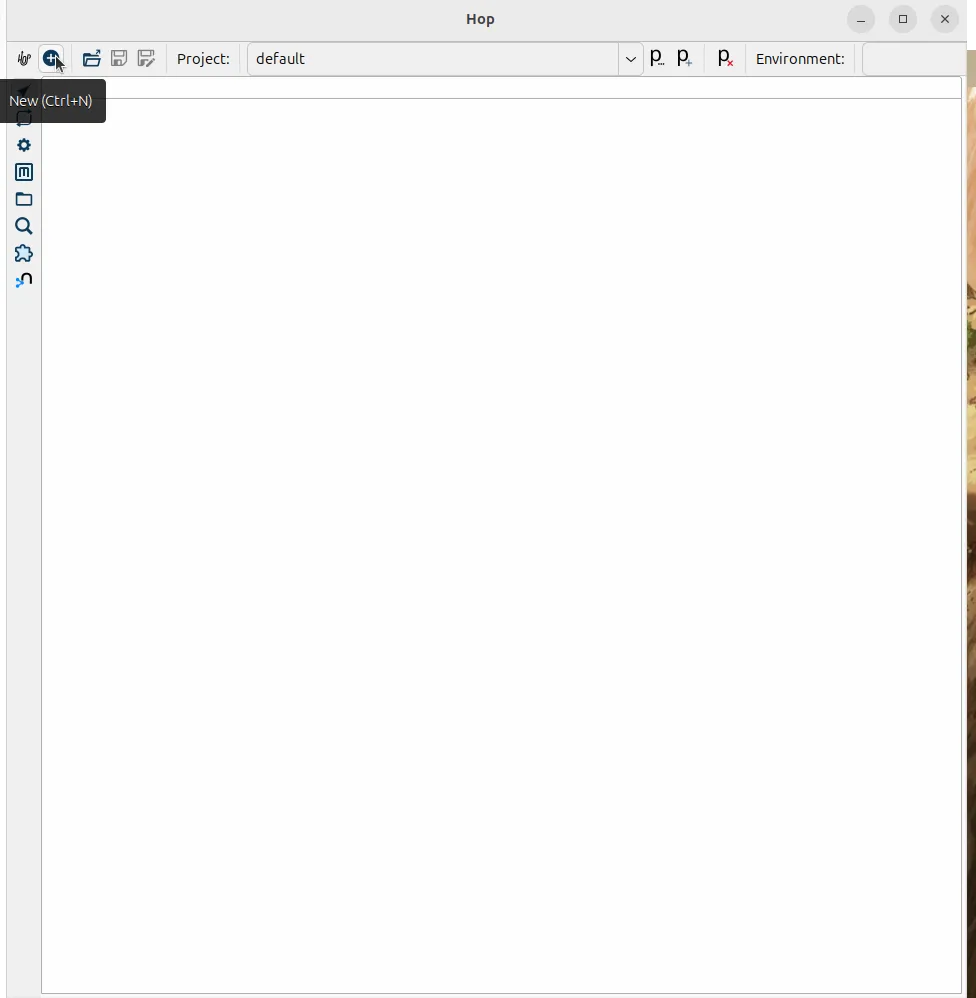
    
2. Click “Pipeline”.
    
    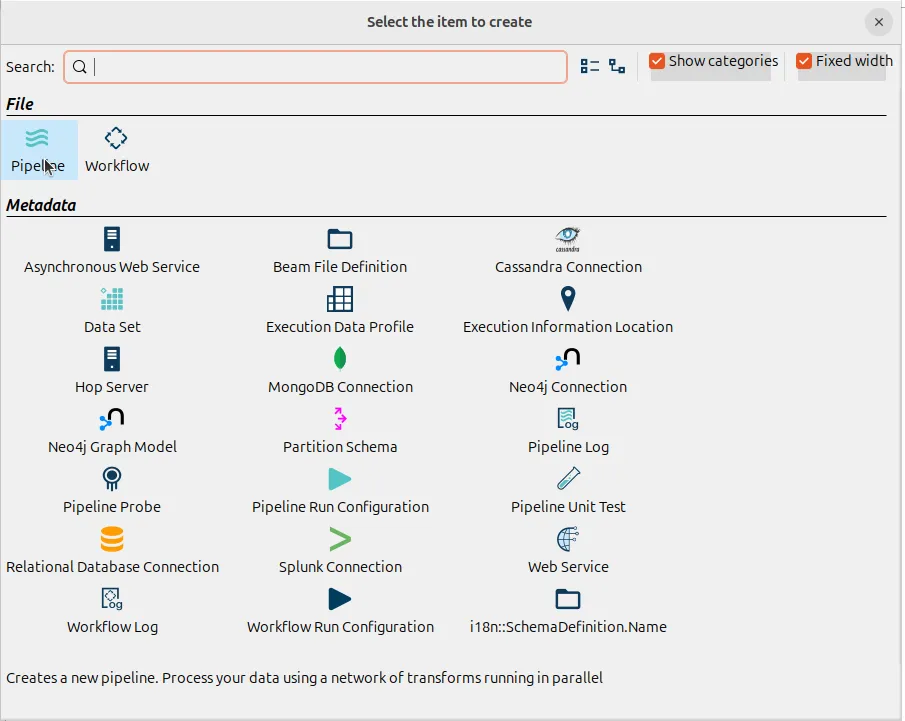
    
3. Click on the blank space of the newly created Pipeline to add a transform.
    
    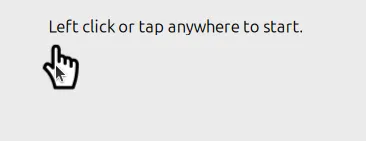
    
4. Select “Table input” as the transform to create.
    
    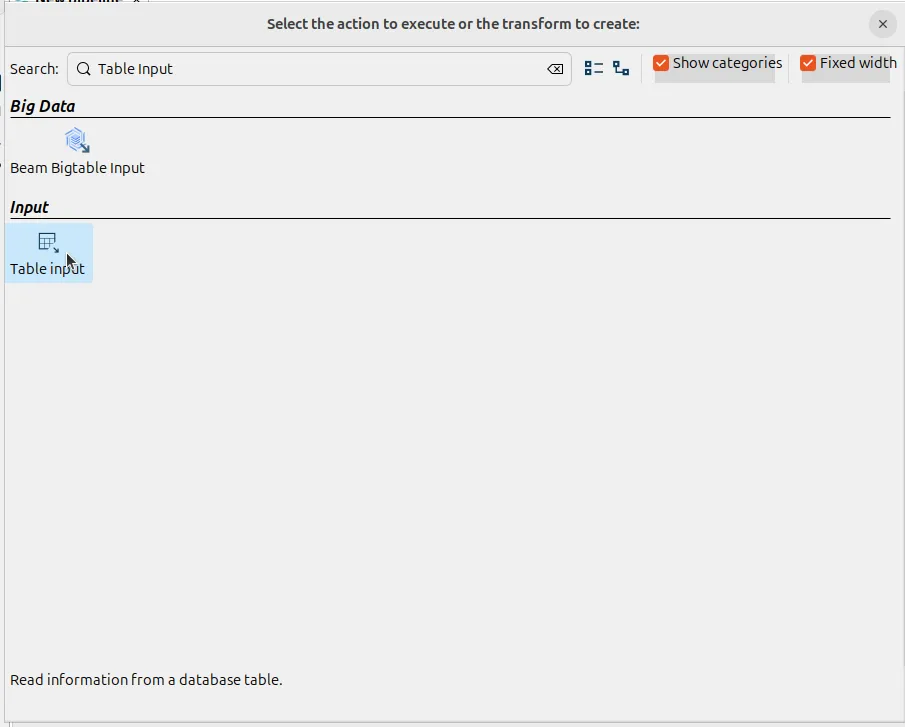
    
5. Click on the newly created “Table Input”.
    
    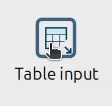
    
6. Click “Edit”.
    
    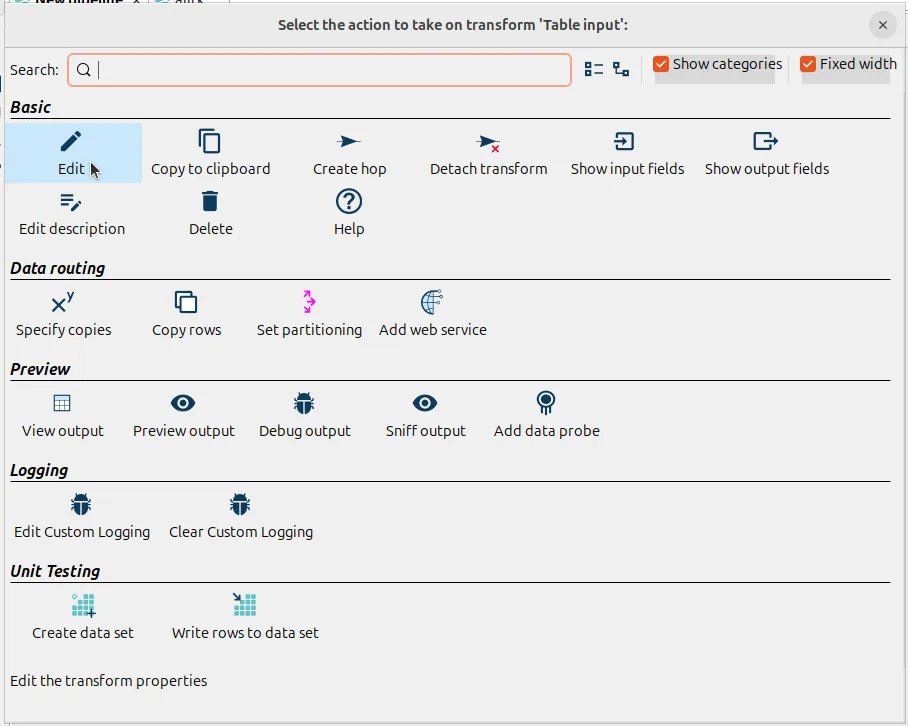
    
7. In the popup window, click on the icon shown below to create a new metadata element.
    
    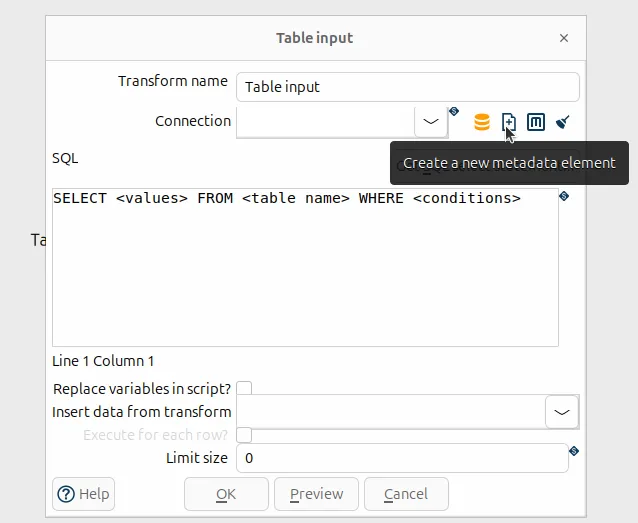

    - Press OK to close the popup and continue.

    
8. Select “MySQL” as the Connection type and input the details shown below. The password for the MySQL server on the Virtual Machine is `DLSU1234!`. Click the “Test” button to check if the connection is successful.
    
    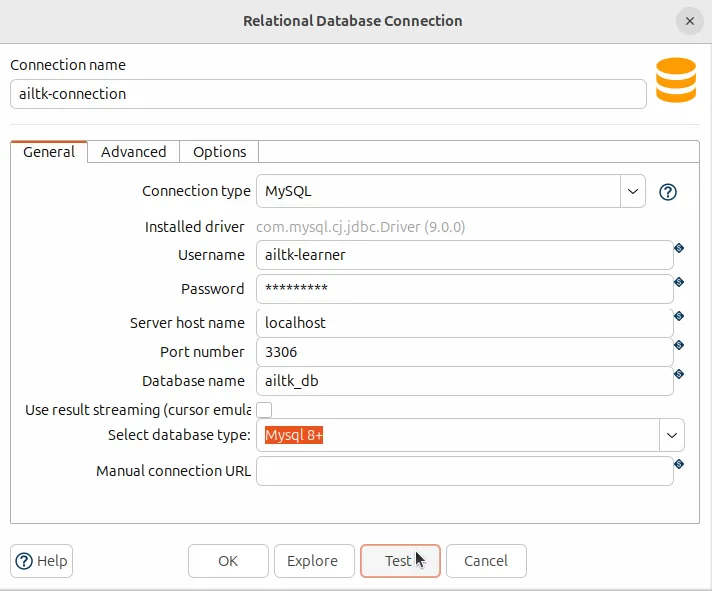
    
9. If the connection is successful you should see a popup similar to the one below:
    
    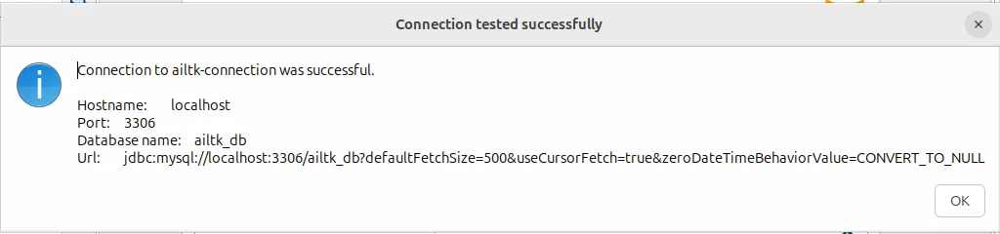

    - Press OK to close the popup window and continue.
    
10. Afterward, click “Edit” in the menu for your "Table input".
    
    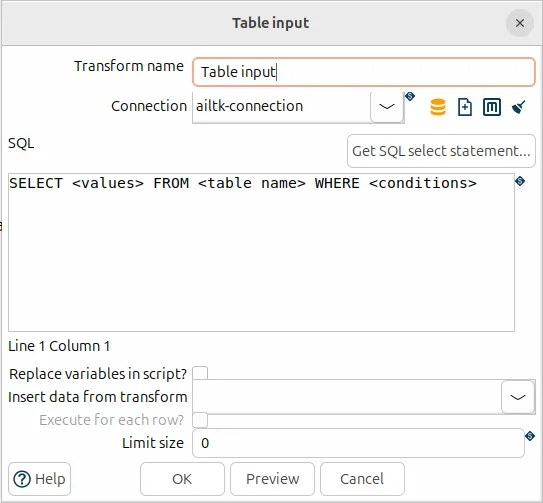
    
11. Click “Get SQL select statement…”
    
    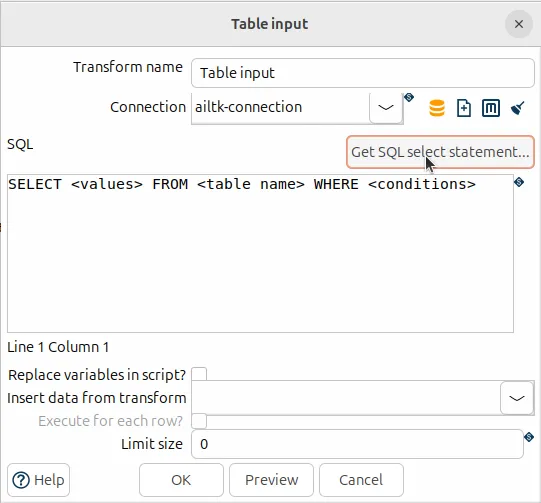
    

12. Navigate to Tables then select “ailtk_db.product_beans”. Afterwards press OK.
    
    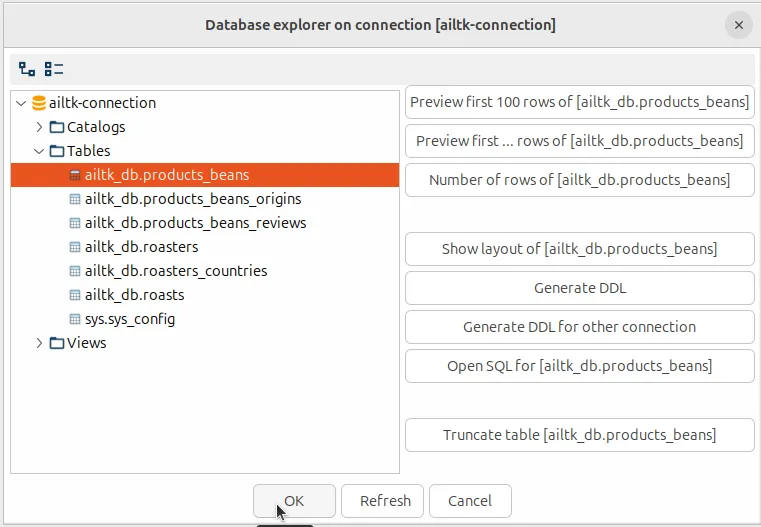
    
13. You will be prompted to include the SQL field-names. Click “Yes” to view the column names. 
    
    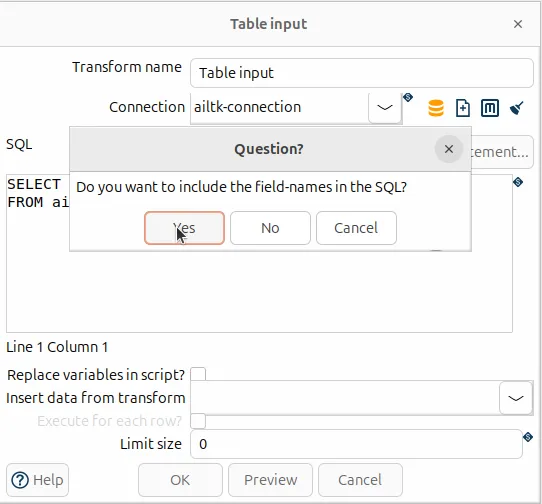
    - The SQL statement will be displayed and ready for use as shown below:

        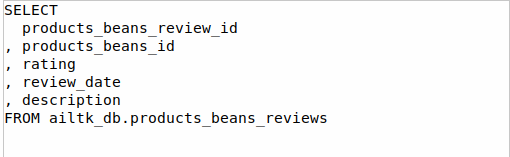

    - Test the SQL select statement by clicking "Preview" (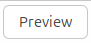). Your output should look like the sample shown below:
        
        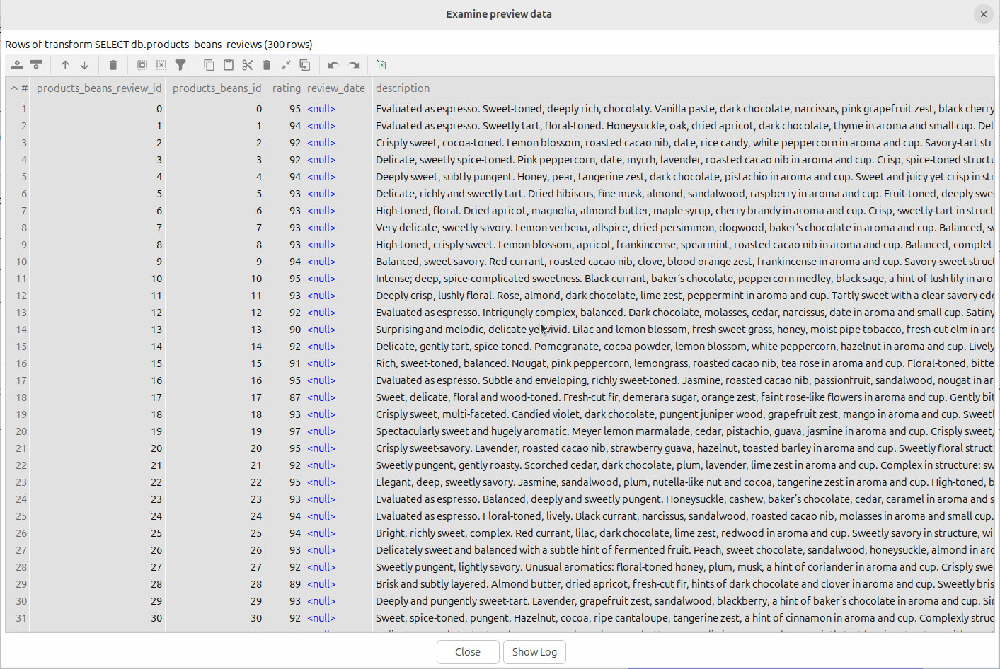
14. Rename the transform for better organization.
    
    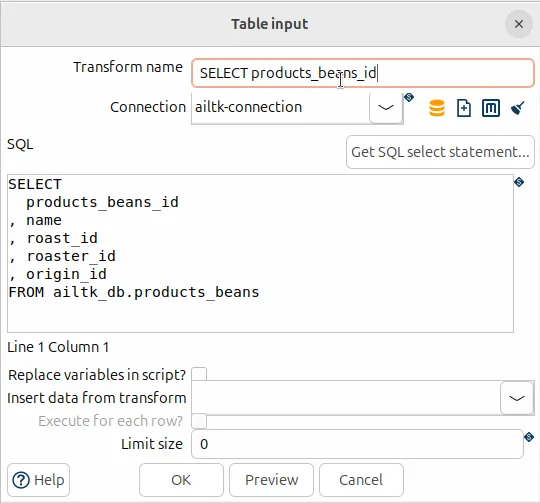

    - Afterward, press "OK" to close the window and continue.
    
15. Using your newfound knowledge from the previous steps, create Table Inputs, get the respective select statements, and preview the data for the other SQL tables in the database: “products_beans_origins”, “products_beans_reviews”, “roasters”, “roasters_countries”, and “roasts”. 
    - You will be able to reuse the connection you made earlier as needed. Selecting `ailtk-connection`, which you should have from the previous steps, from the dropdown will allow you to get the SQL select statements of the other tables.
    
    - 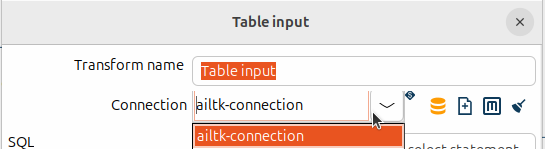

    - 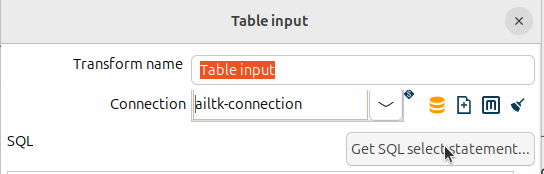 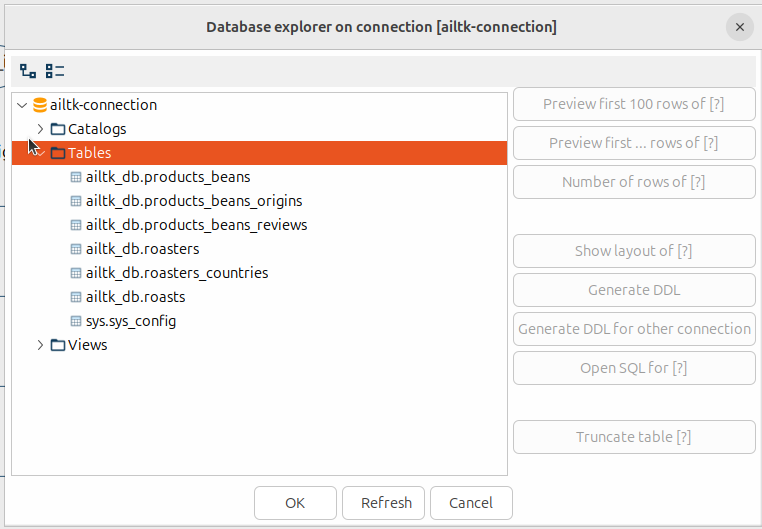

- Once all your Table inputs are setup and renamed appropriately, your output should look similar to this:
    
    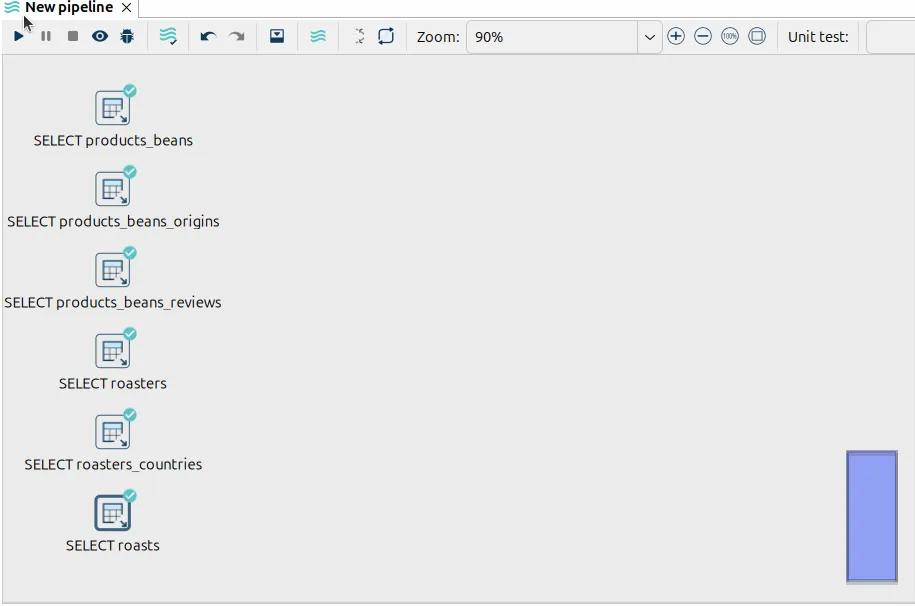
    
16. Now that your tables and their respective data are loaded, we can get to merging data together. In Apache Hop, tables’ data must be sorted on their common keys prior to merging. Click on an empty space on the pipeline and add a “Sort rows” transform. 
    
    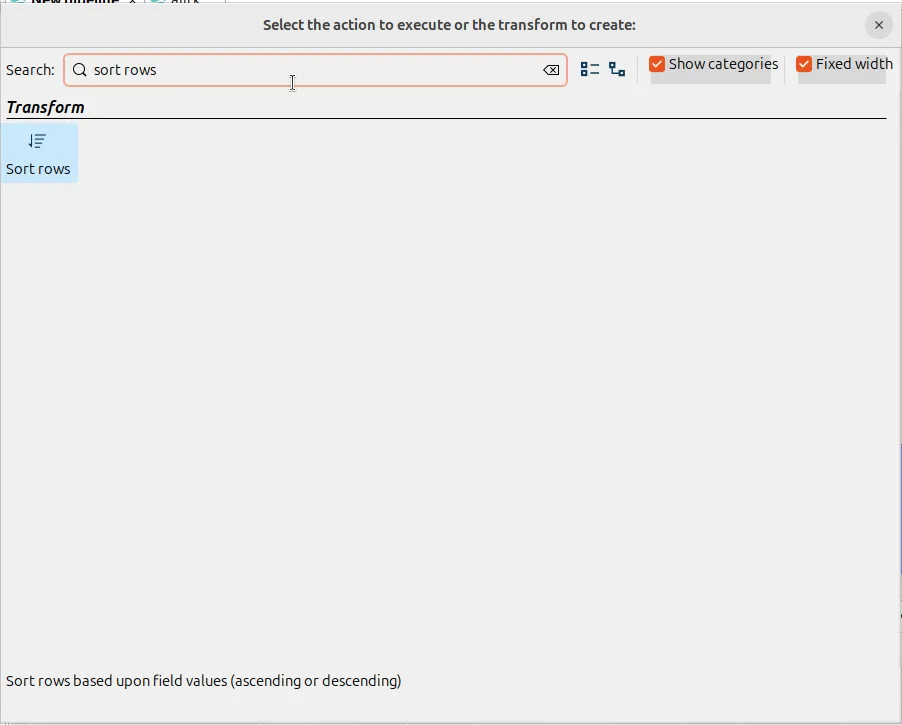
    
17. Duplicate the sort by left clicking and dragging over the newly created "Sort Rows entry", pressing `Ctrl + C`, then `Ctrl + V`
    
    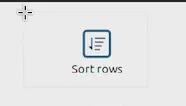
    
    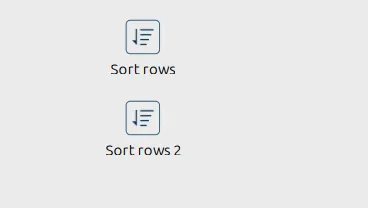
    
18. Click on the "SELECT products_beans" table input then “Create hop”

    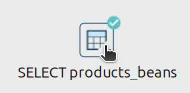

    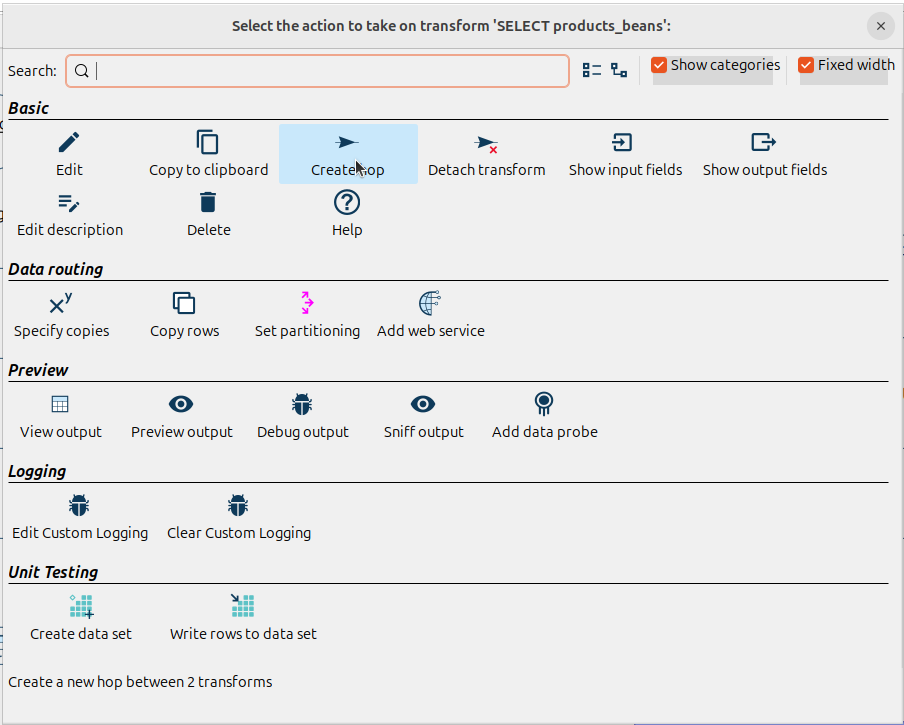

19. Afterwards click on “Sort rows” to direct the data to that transform
    
    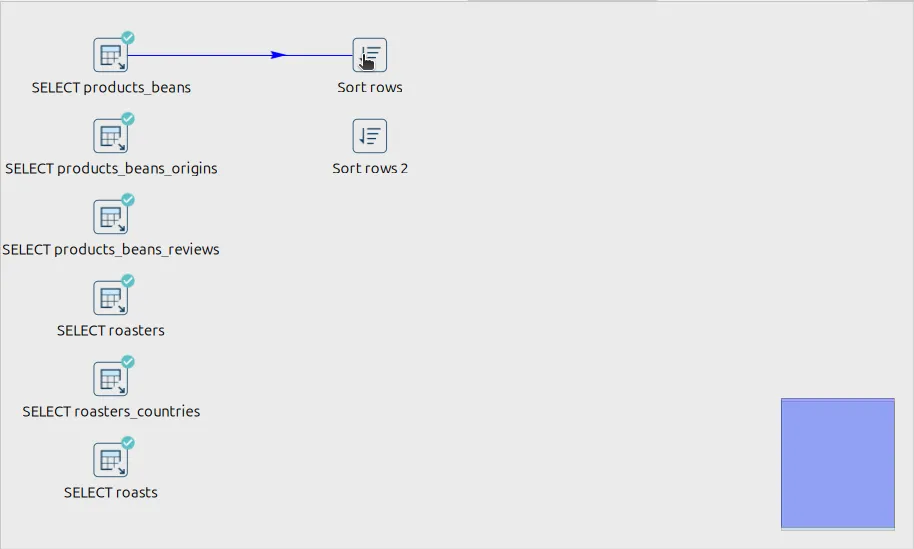
    
20. Do the same for "SELECT products_beans_origins" and "Sort rows 2"
    
    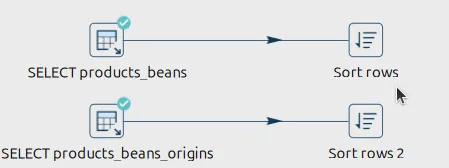
    
21. Click on the “Sort rows" transform then “Edit”

    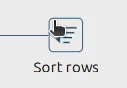

    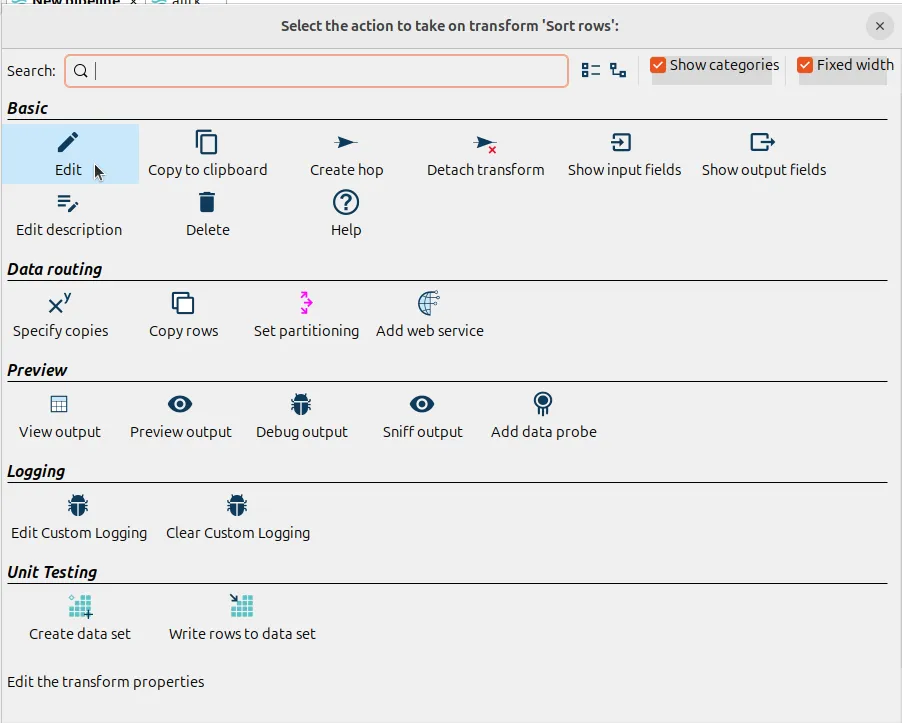

22. Click on the first row then select “origin_id” 
    
    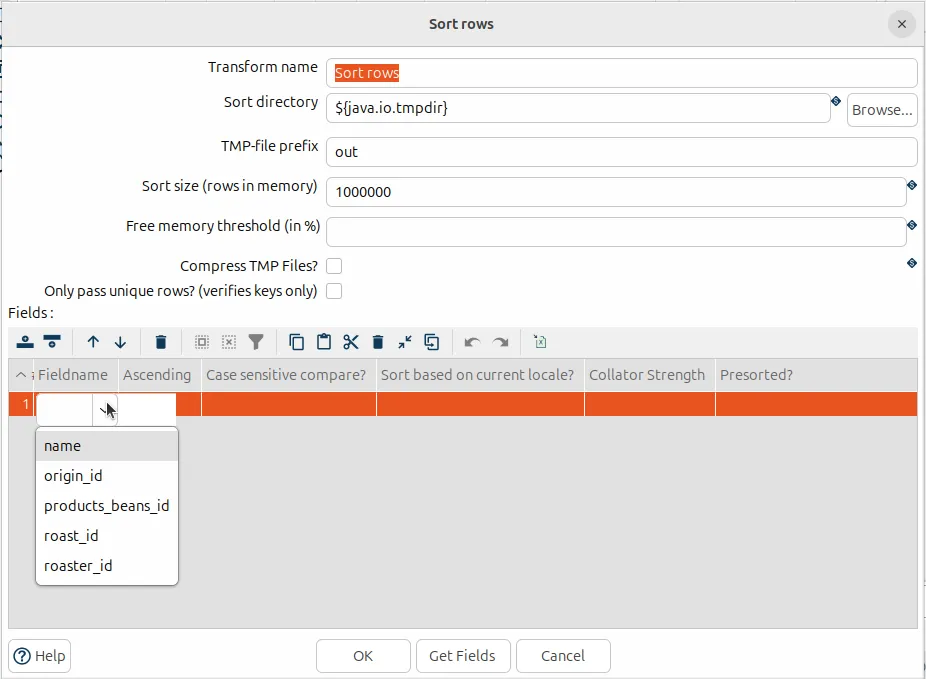
    
23. Rename the "Sort rows" transform for better organization then press OK. Shown below is the naming convention we will follow for this Pipeline.
    
    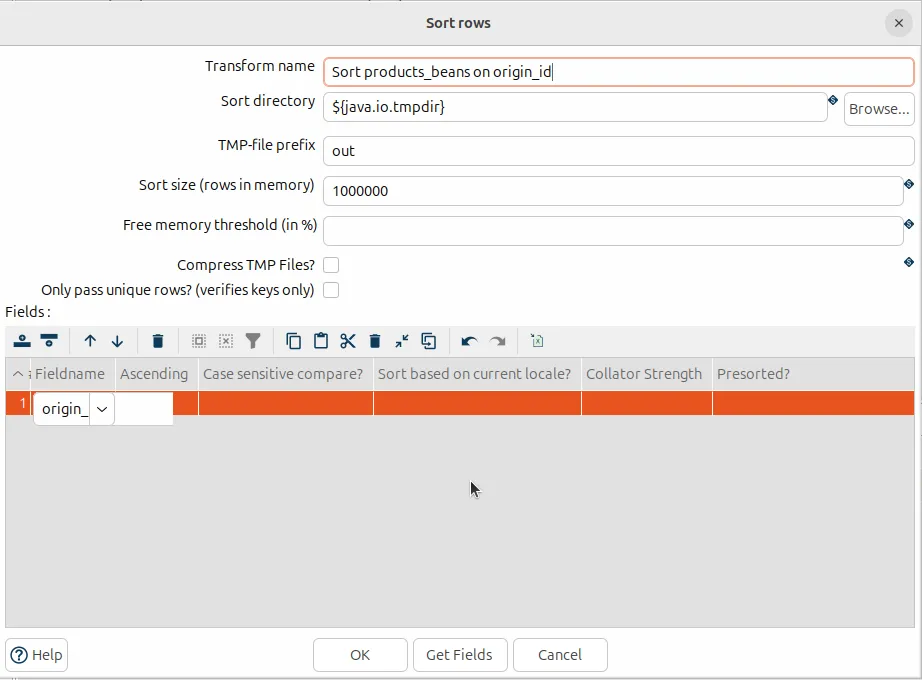
    
    You may also click on Preview output to test the steps
    
    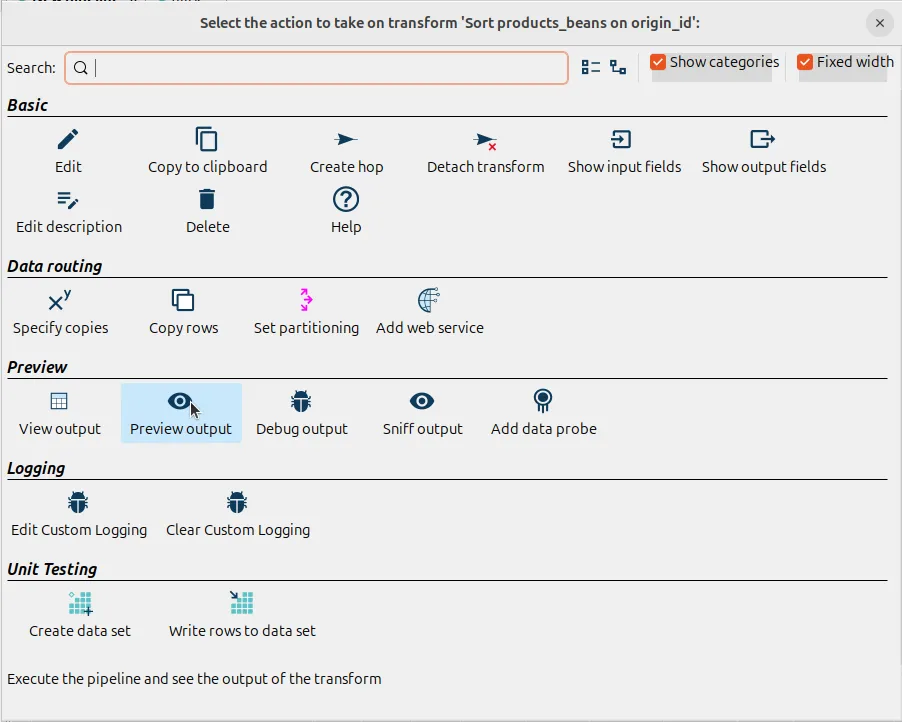
    
    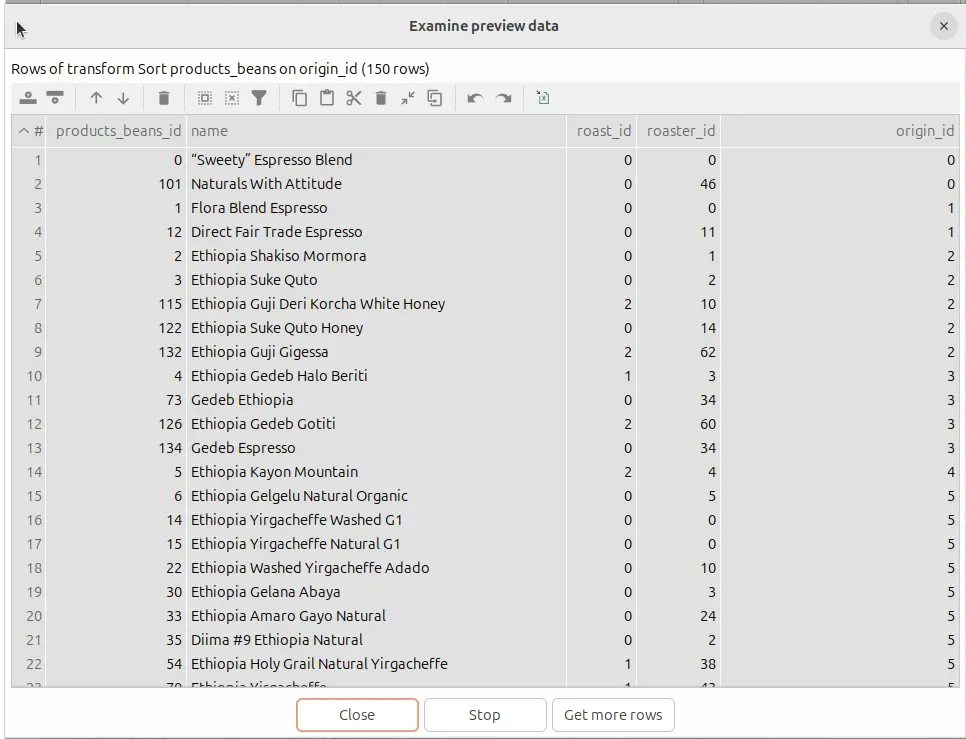
    
24. Repeat steps 21 to 23 for “SELECT product_beans_origins” and “Sort rows 2”
    
    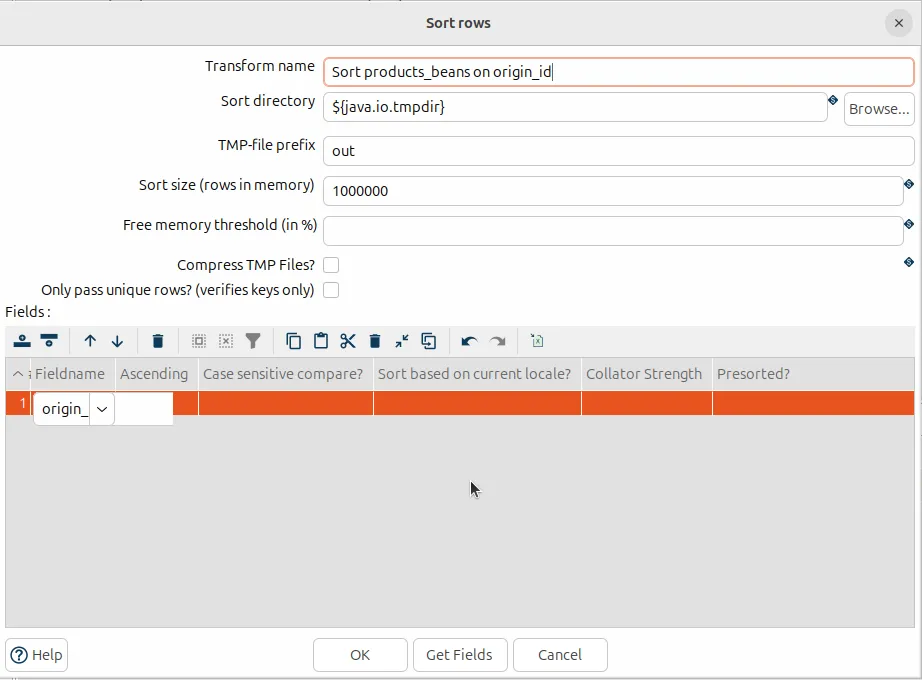
    
25. Click on an empty space on the pipeline and add a “Merge join” transform. 
    
    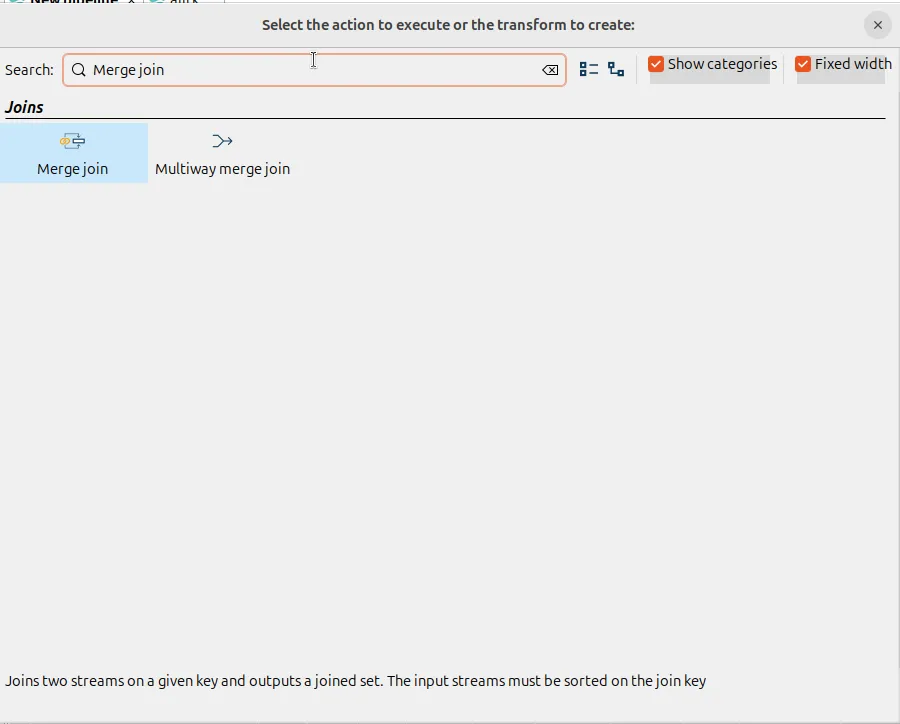
    
26. Create respective hops from the two sorts previously created
    
    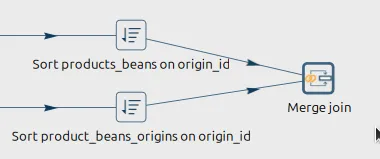
    
27. Click on the newly “Merge join” then “Edit”

    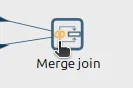

    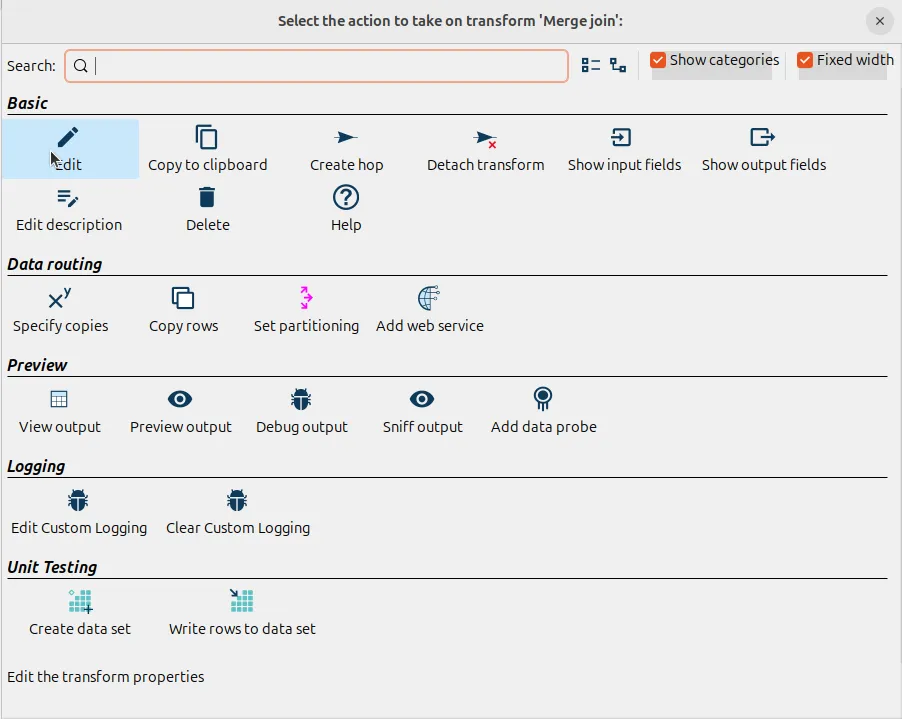

28. Select “Sort product_beans on origin_id” for First transform and “Sort product_beans_origins on origin_id” for Second transform 
    
    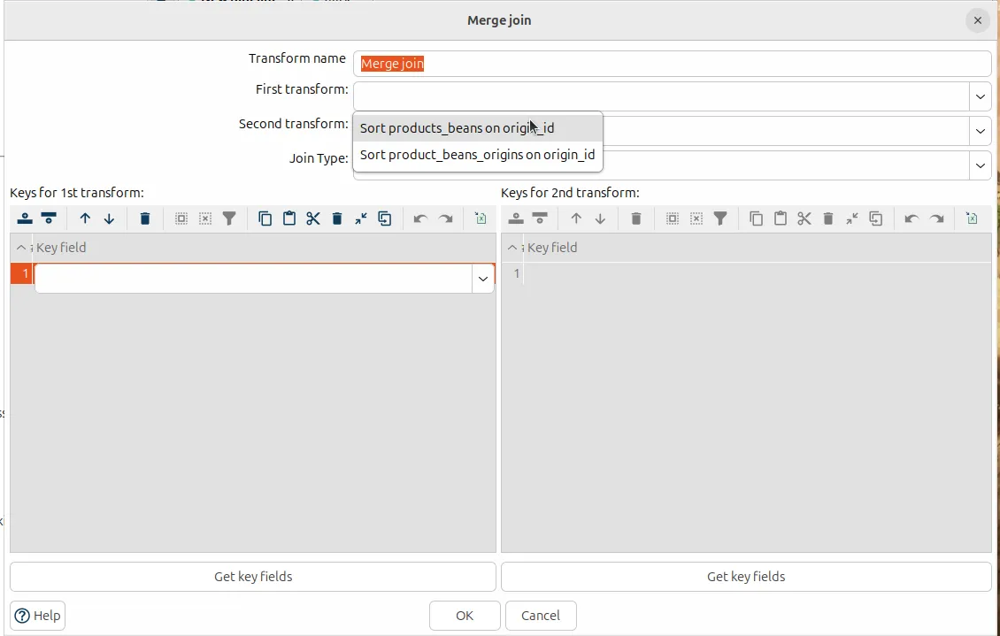
    
    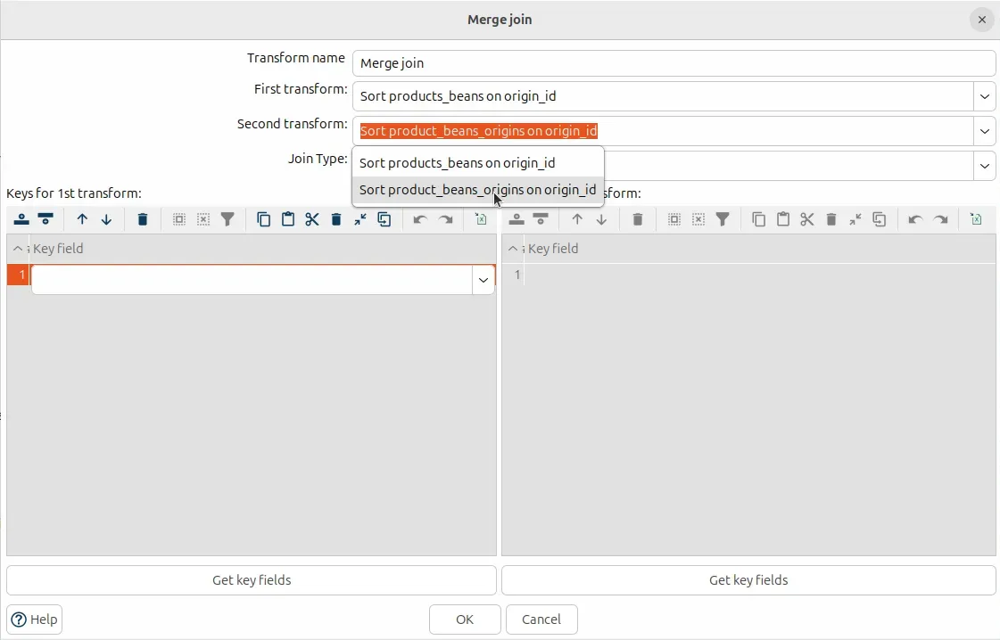f3874153-f27b-4c46-8351-9b9da10db5d5.png)
    
29. Select “origin_id” as the keys for both fields
    
    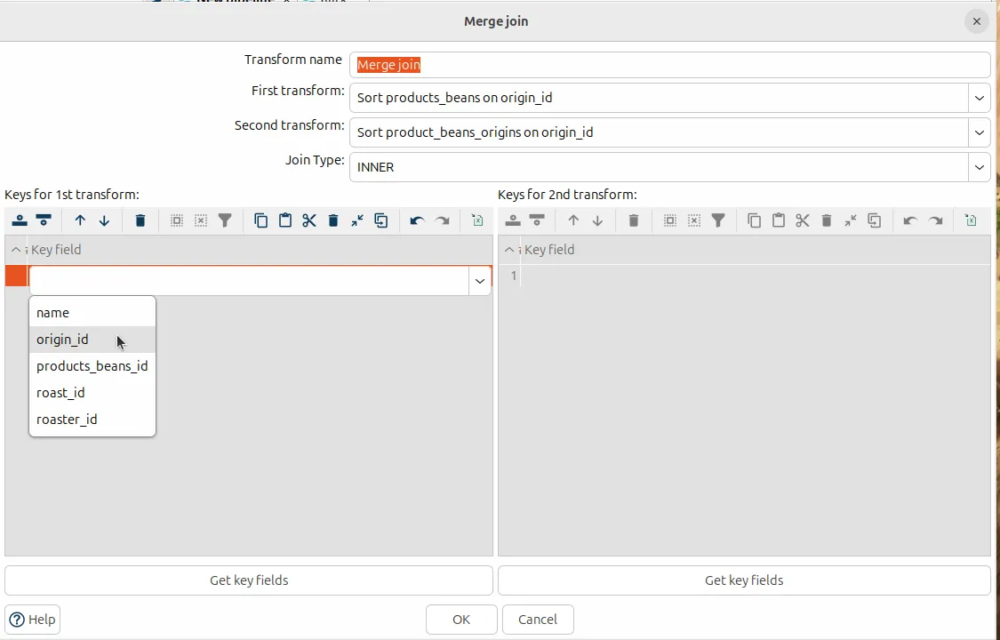
    
    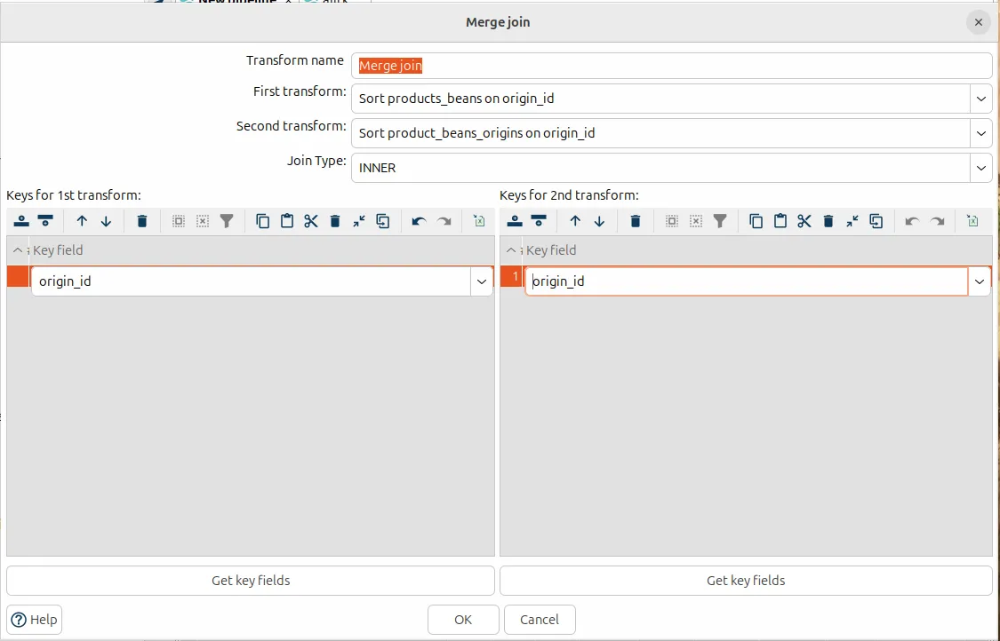
    
30. Rename the transform for better organization
    
    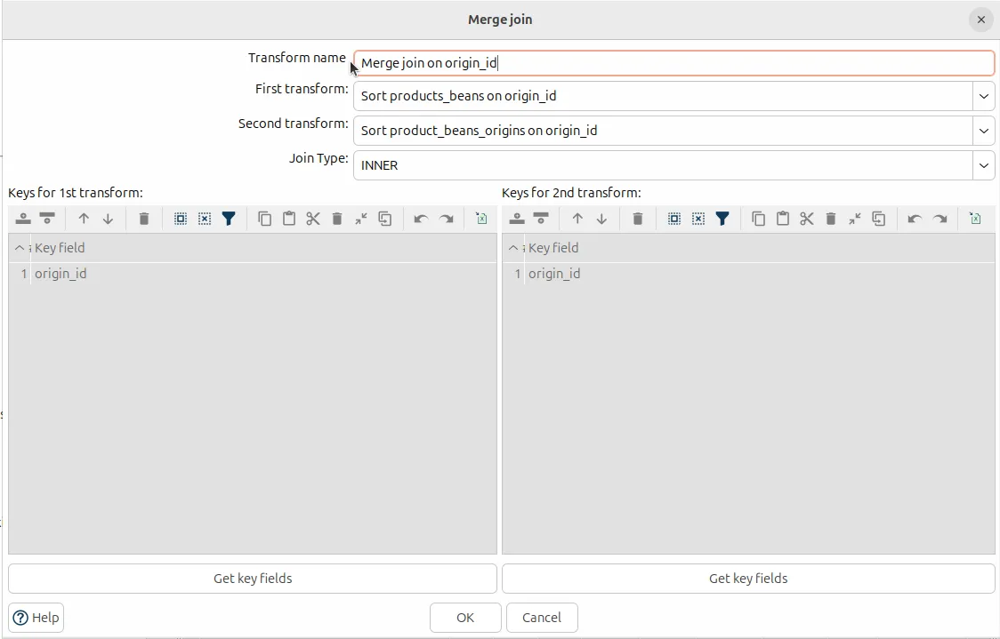
    
31. Pressing OK will issue a warning regarding sorting data on the specified keys. Close this and preview the output of the Merge join to check if it is working.
    
    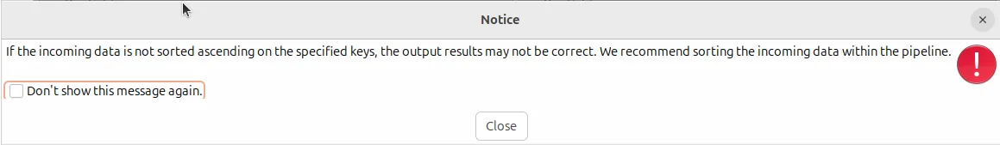
    
    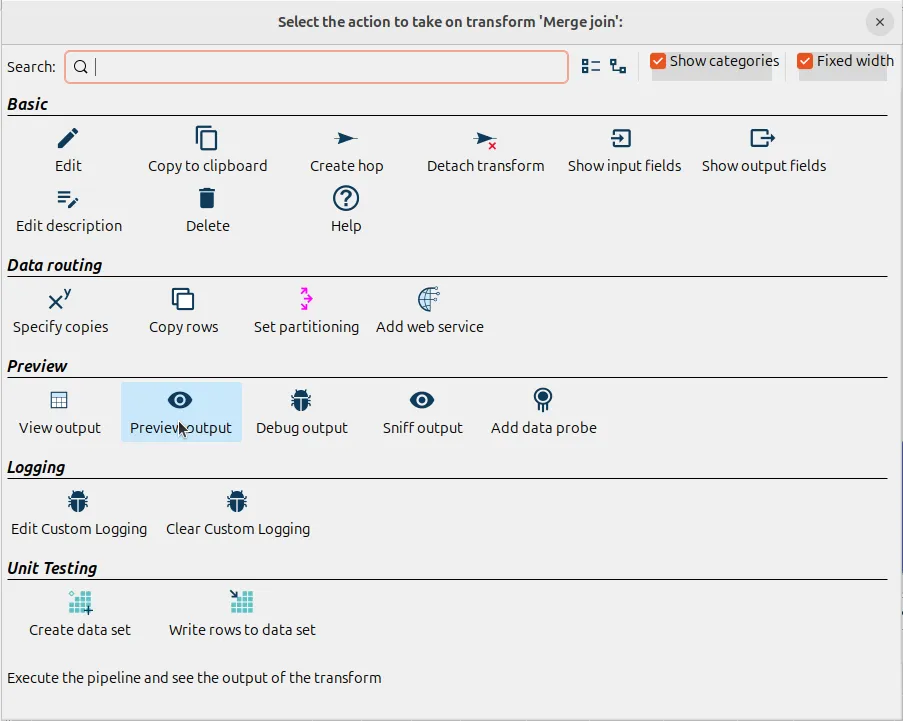
    
    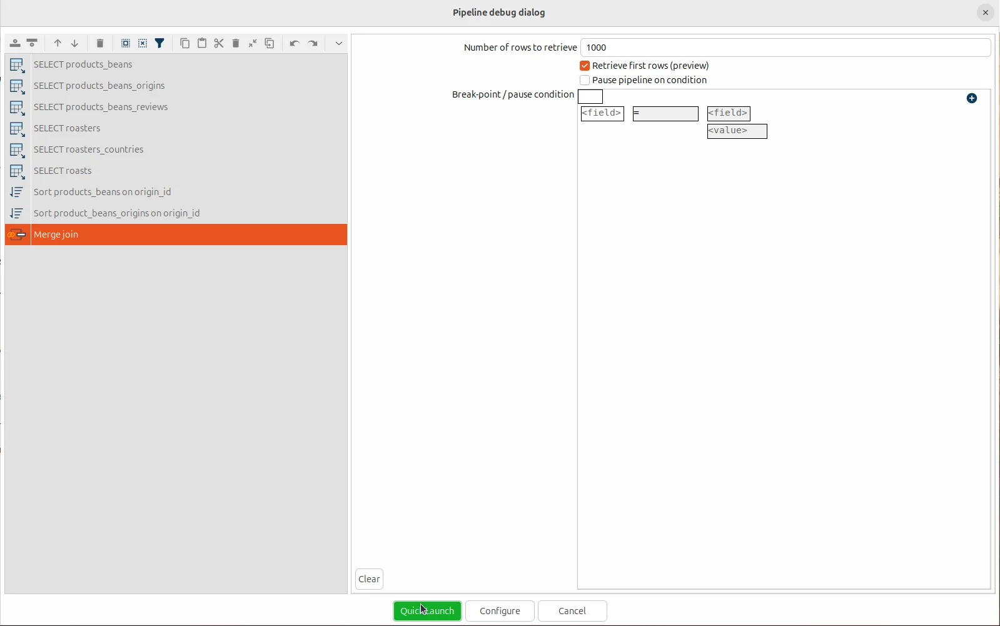

    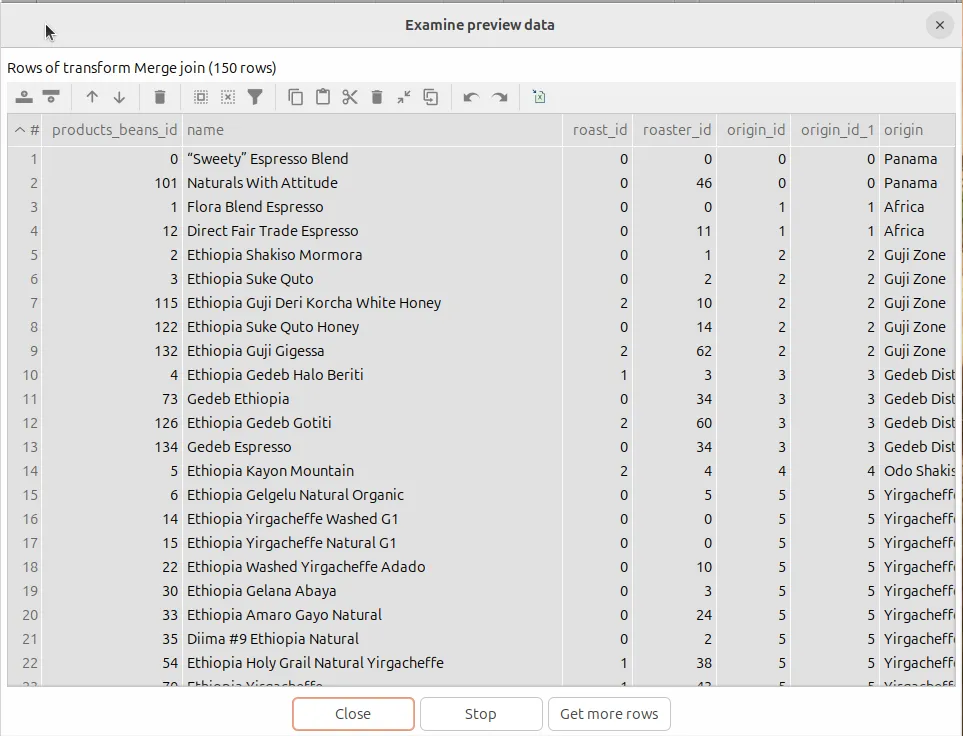

- We will refer to the data coming from the resulting merges our “primary stream”.
32. Add two more “Sort rows” transforms
    
    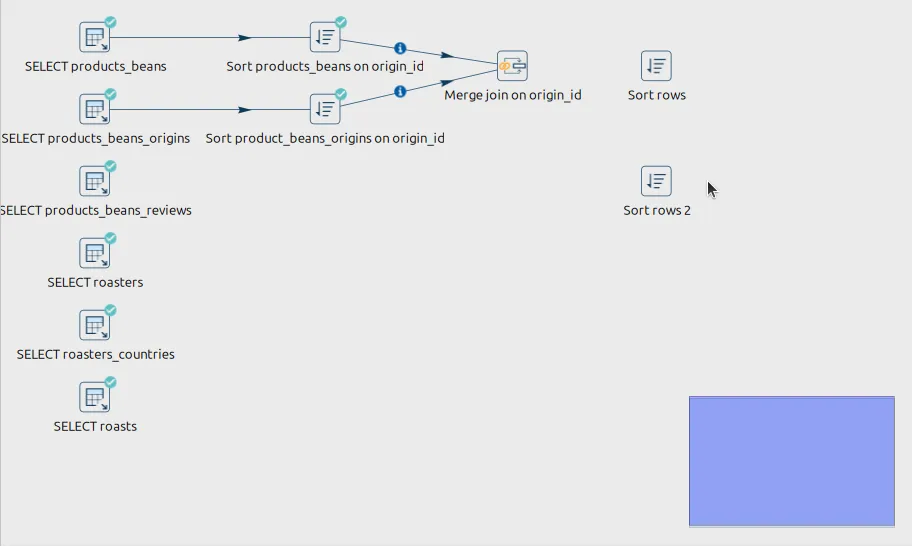
    
33. Create hops from “Merge join on origin_id” and “Sort rows” and “SELECT products_beans_reviews” to “Sort rows 2”, respectively.
    
    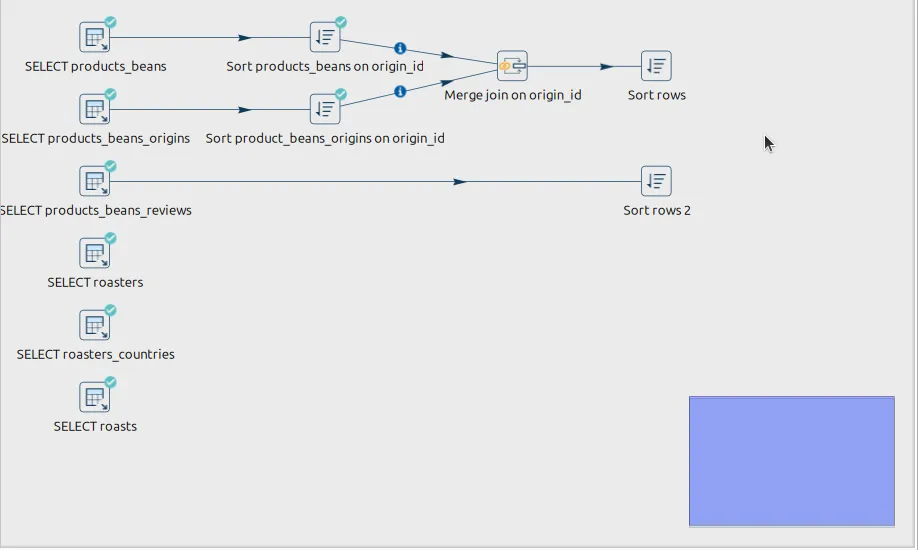
    
34. Edit “Sort rows” and “Sort rows 2” to sort their incoming streams on “product_beans_id and rename accordingly.
    
    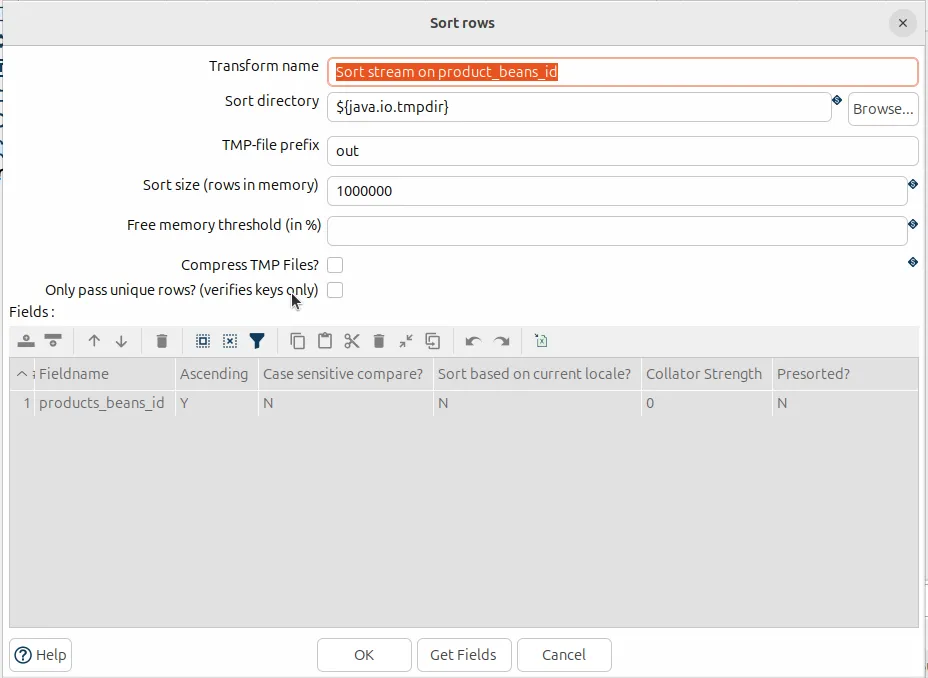
    
    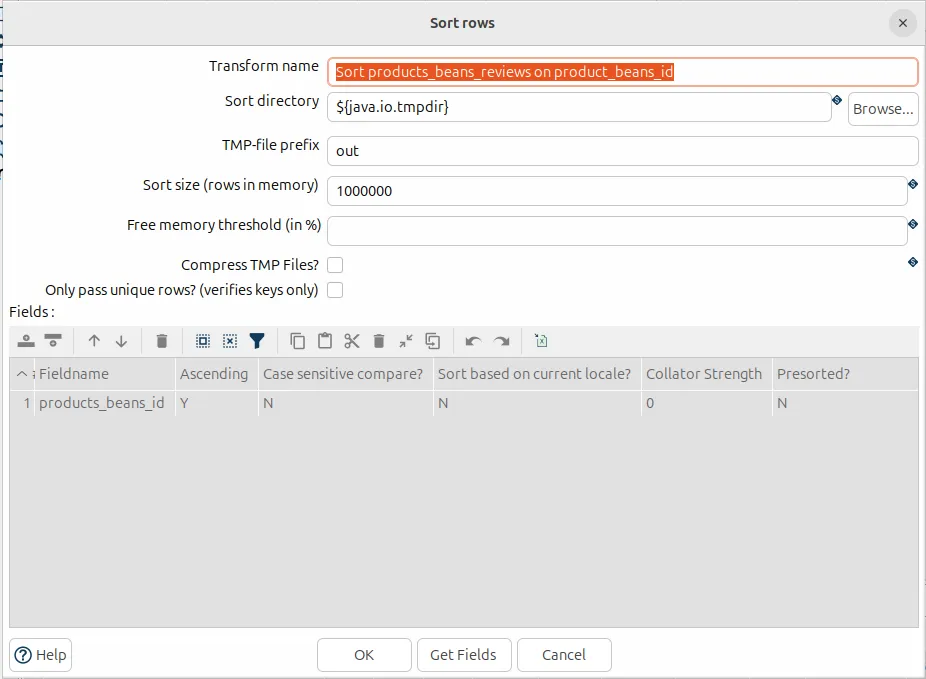
    
35. Add another Merge join and create hops from the two sorts.
    
    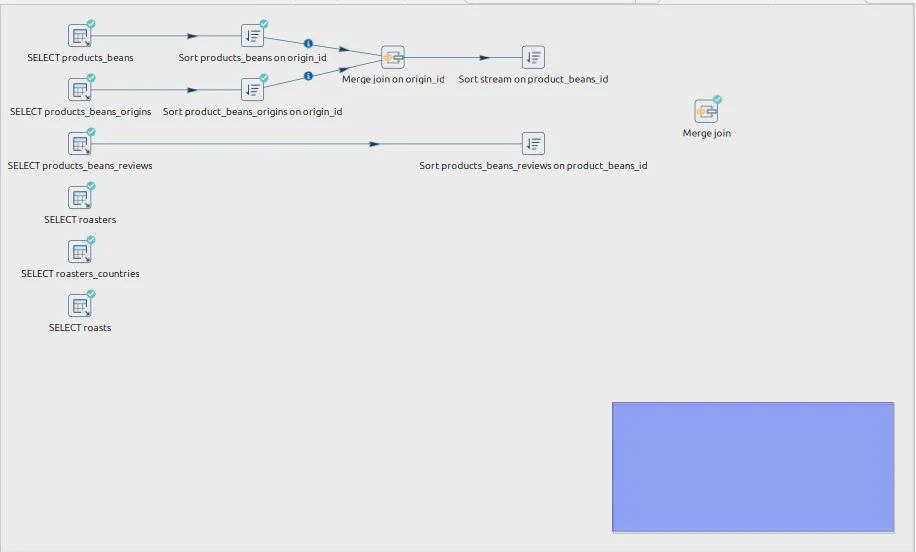
    
    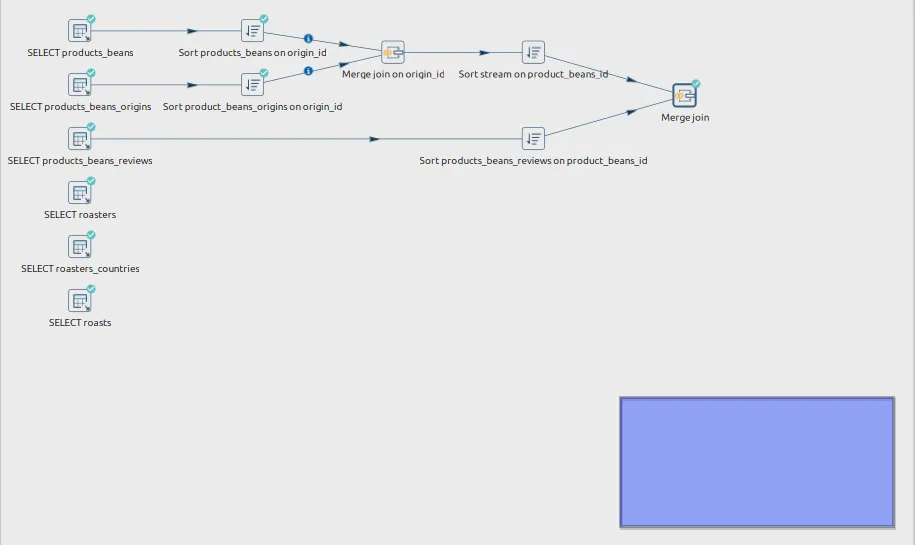
    
36. Edit the newly created “Merge join” accordingly and examine its preview data.
    
    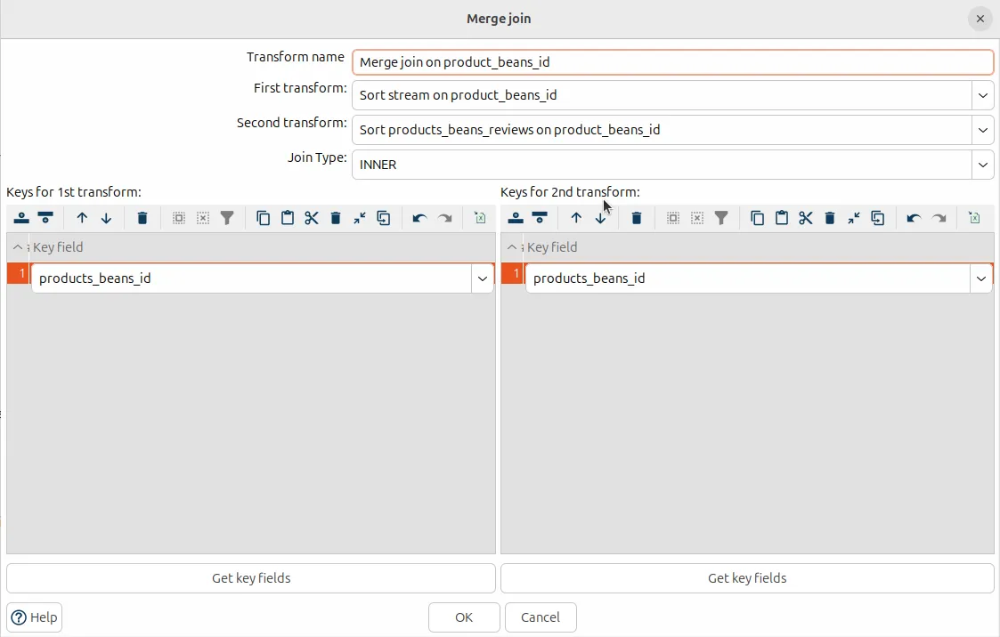
    
    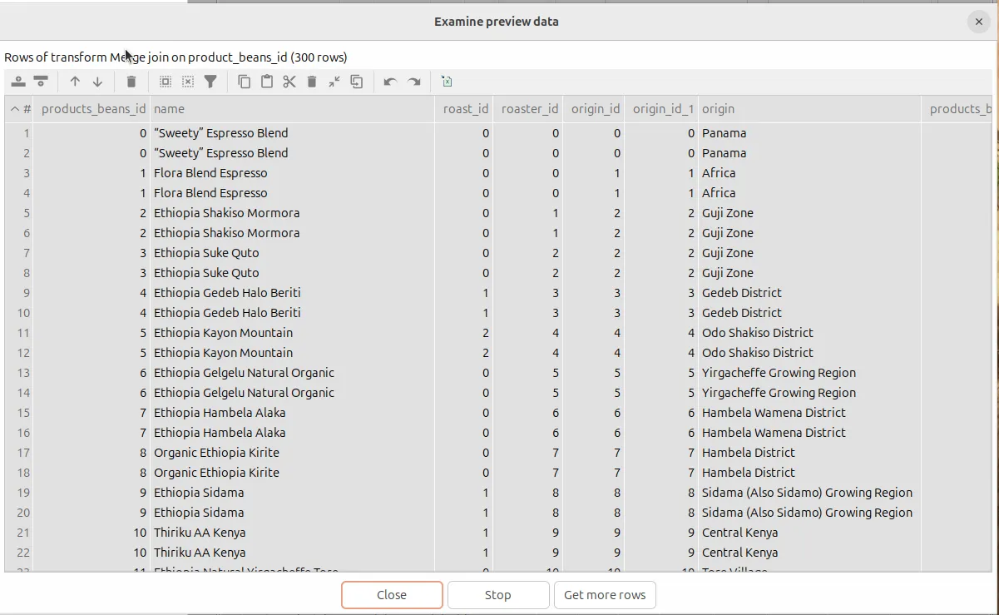
    
    - Notice that the columns we merge on are duplicated. We will deal with these later.
37. Repeat steps 31 - 35 for the remaining SQL tables. Refer to this guide for the tables and the keys on which they share with the primary stream for merging.
    
    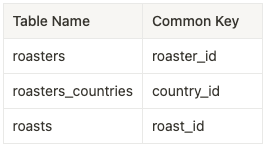
    
    - Your output should look similar to this:
        
        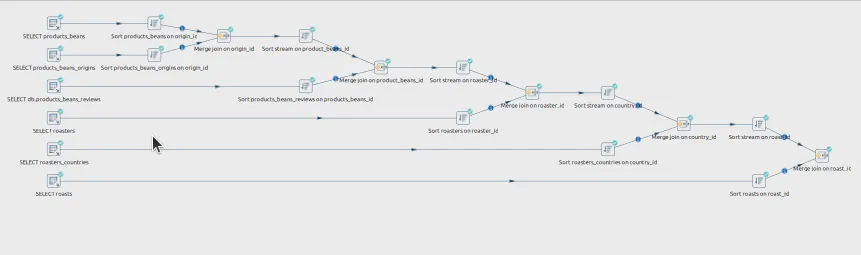
        
38. After merging all the SQL tables into one stream, preview the output data.
    
    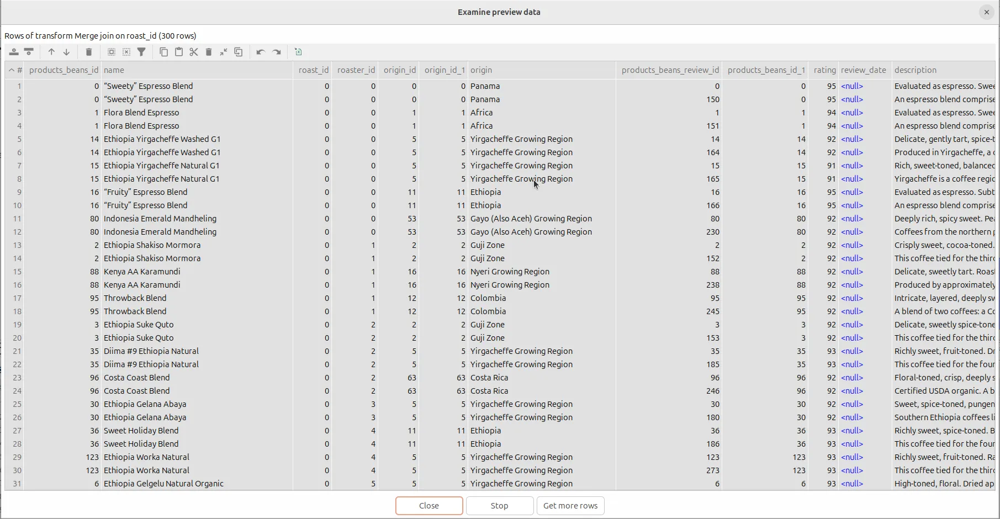
    
    - We can notice that there are columns with repeating values and a column (review_date) consisting of null values.
39. Add a “Select values” transform to the pipeline
    
    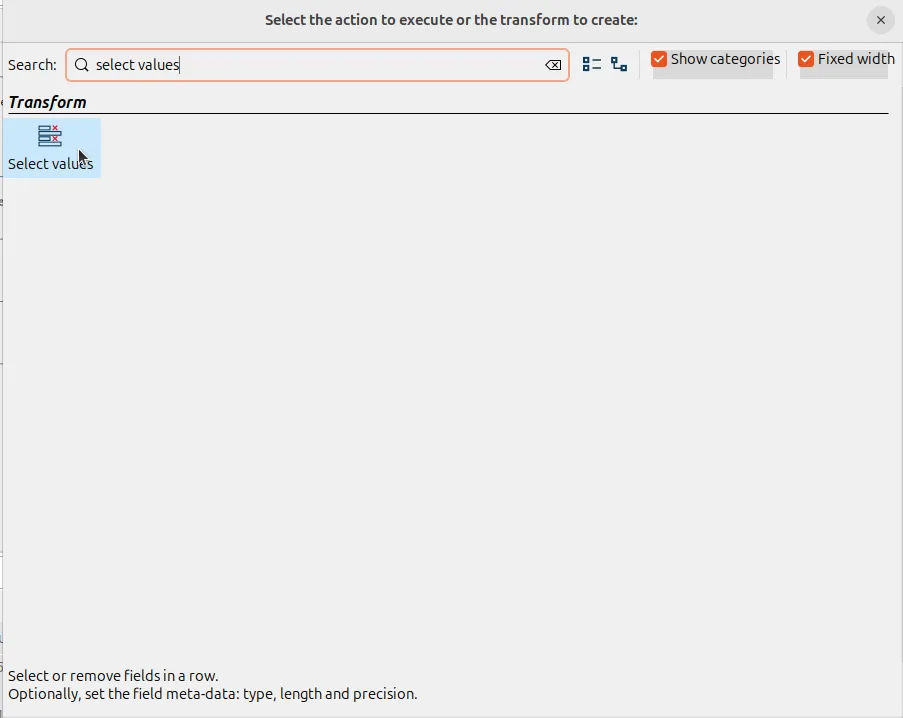
    
40. Create a hop to it from the primary stream.
    
    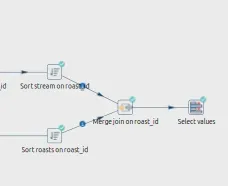
    
41. Here, we will the values while leaving out the id columns, their duplicates, and any other columns we don’t need (the “review_date” composing of null entries). In the “Rename to” column, type in “input” on the row of “name”. This will serve as the input column for our RAG data. We will leave the “Transform name” as is
    
    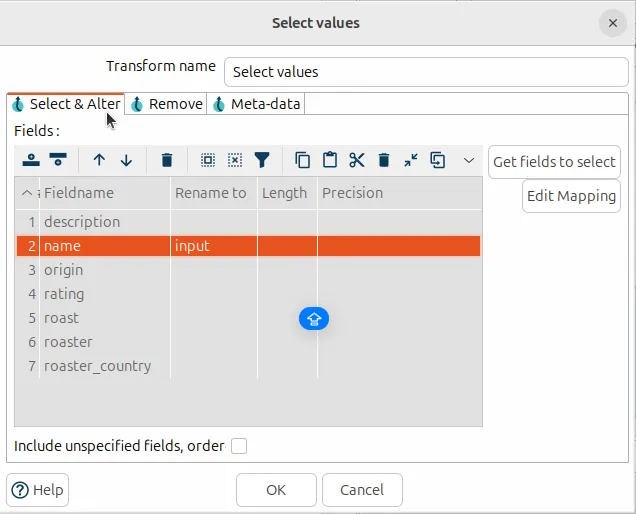
    
42. Next we will add data labels to our rows. This is because our data later on will be appended and will lose their headers. Start by clicking a blank space on the pipeline and adding  an “Add constants” transform. 
    
    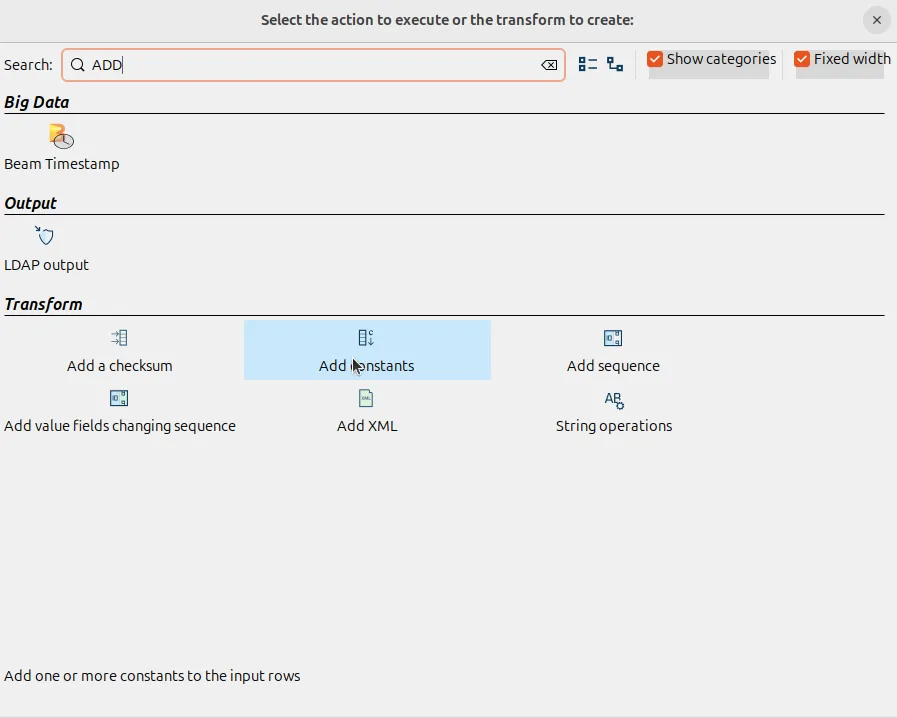
    
43. Add a hop going into the “Add constants” transform
    
    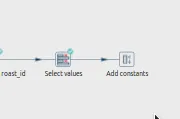
    
44. Edit the “Add constants” transform and input the column names appropriately into “Value” field with type String. We can distinguish the data label columns we are making by naming them appropriately as well. We will not have to be particular with format and length yet. We also rename the transform to “Add data labels” for better organization
    
    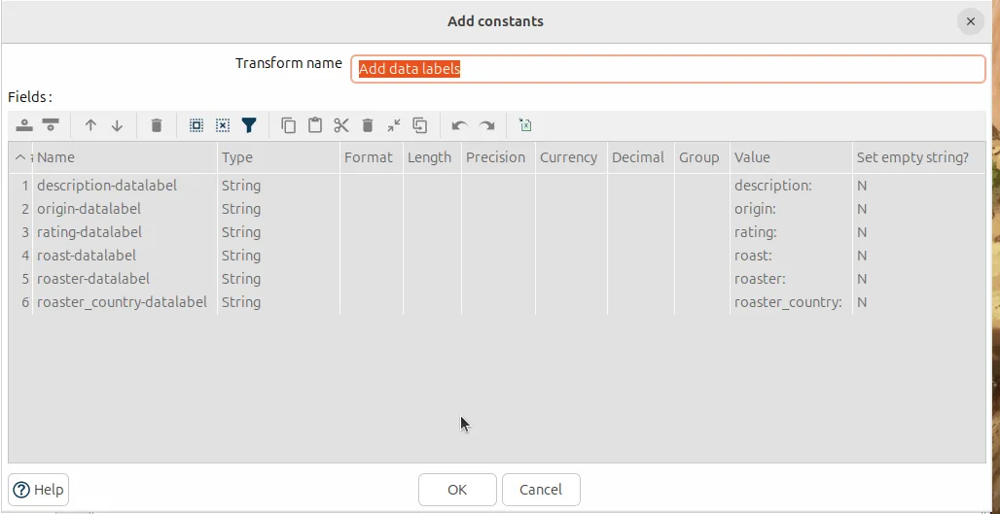
    
45. Click on a blank part of the Pipeline and add a “Concat Fields” transform. 
    
    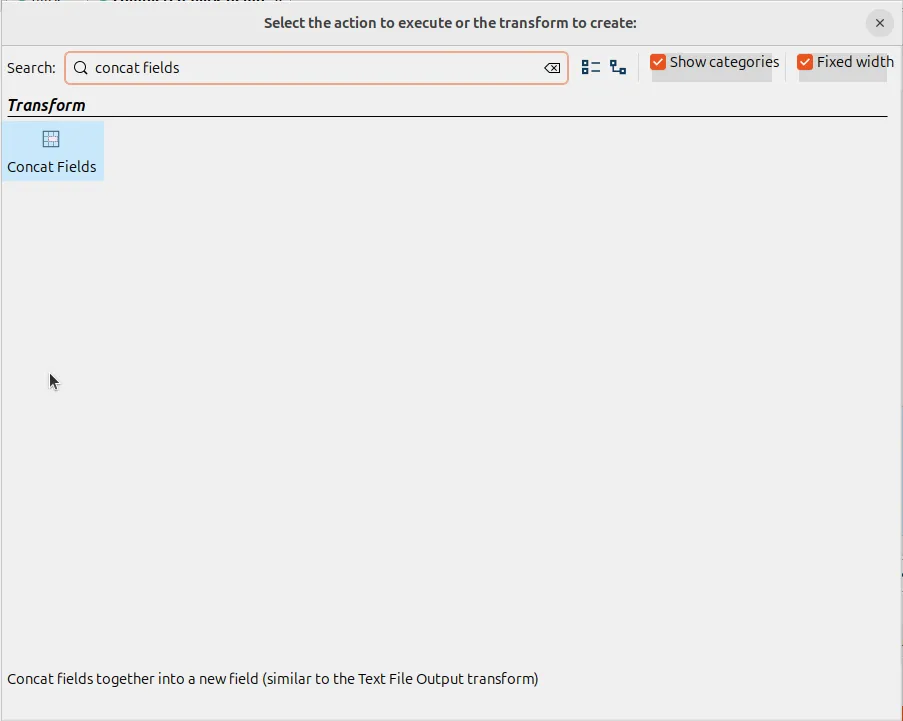
    
46. Create a hop from the primary stream into the newly created “Concat Fields” transform
    
    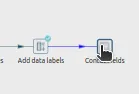
    
47. Select the fields to concat appropriately. We will set the “Target Field Name” as “output”. We will also check the option to “Remove concatenated fields from output”.
    
    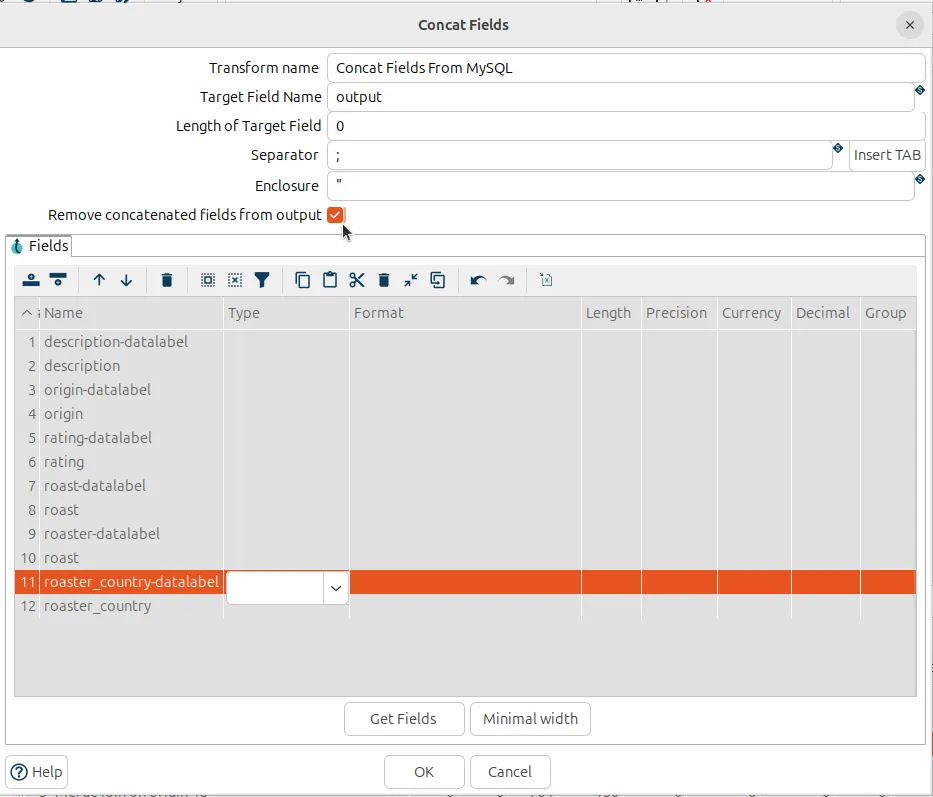
    
    - While the output of this step may be confusing to a human, the LLM being used will be able to breakdown the concatenated fields into tokens, taking into account the Separator between columns.
48. Now that we have transformed the data from the MySQL tables into input and output columns suitable for RAG implentation, let us do the same for the .csv file provided in the case. Click a blank space in the pipeline and insert a “CSV file input” transform
    
    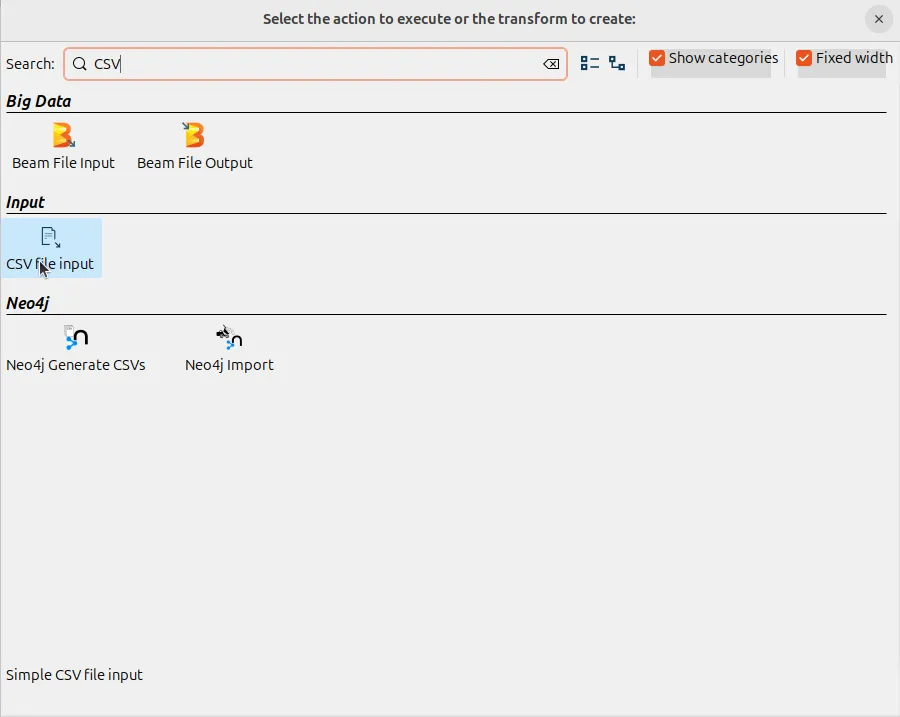
    
    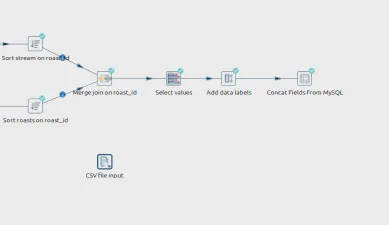
    
49. Click “Browse” and open `/ailtk_learning-management-module/learning-files/coffeepro-online-resources-exported.csv`
    
    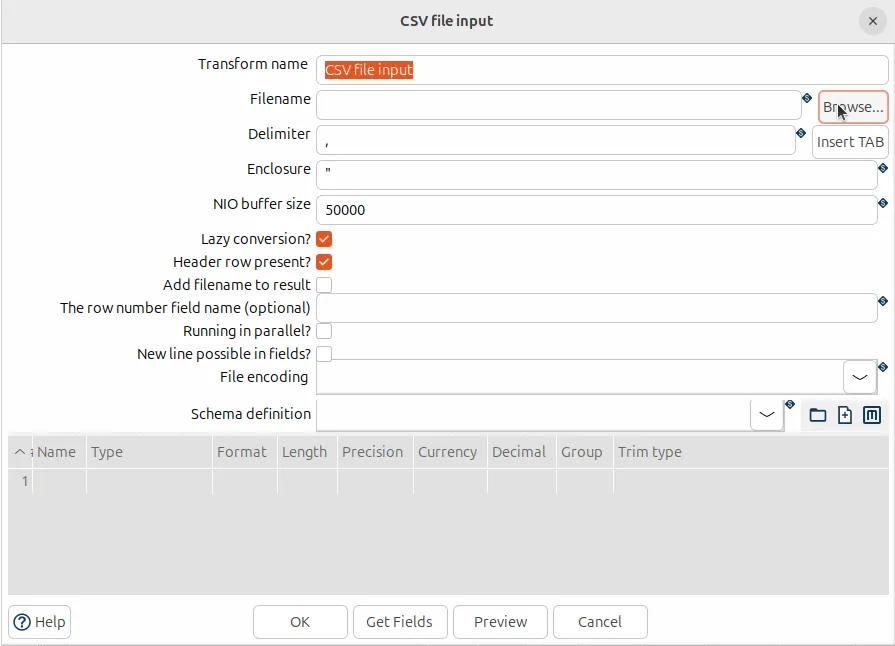
    
    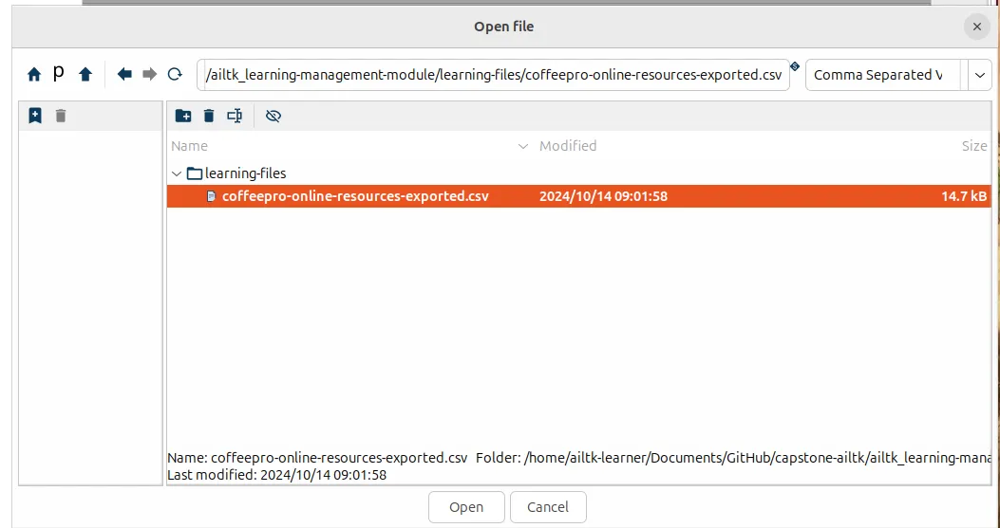
    
50. Click the “Get Fields” button. Use the default “Number of lines to sample” (100) and press OK. You may click the "Preview" button to check if the selected CSV file is being read from.
    
    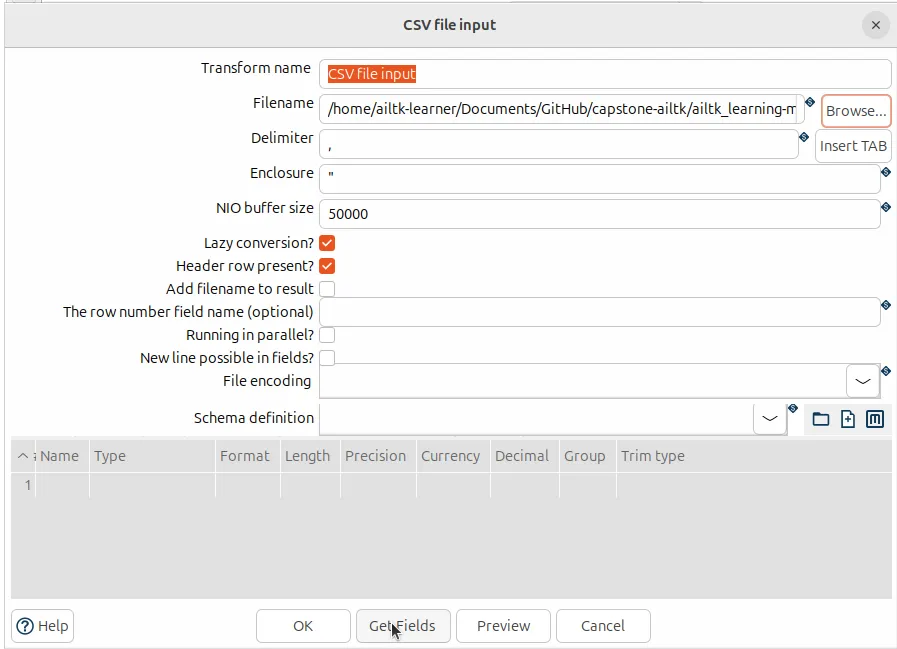
    
    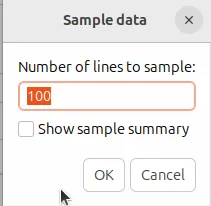
    
    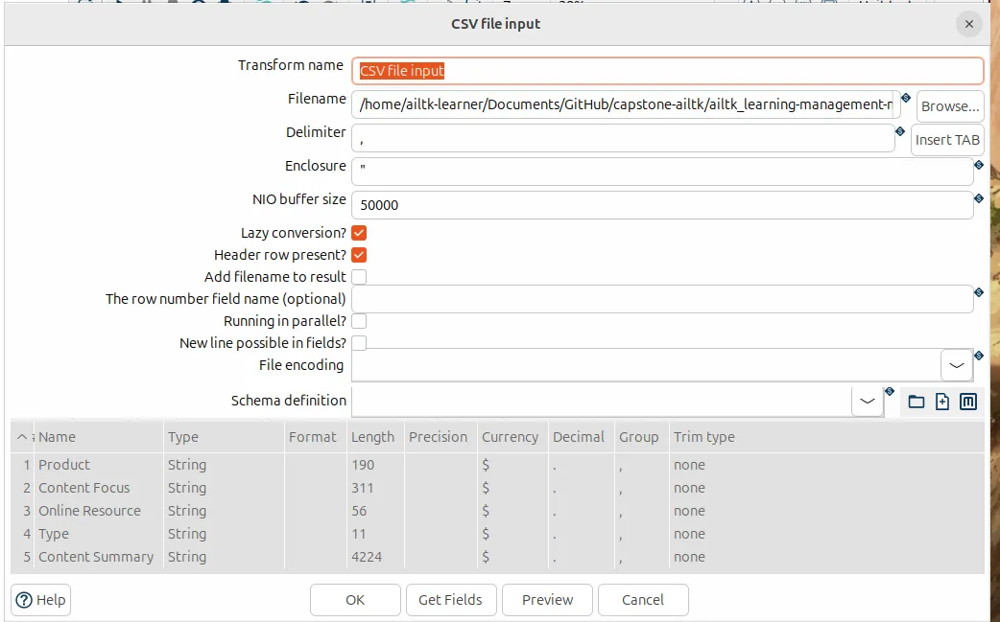

    - Clicking the "Preview" button will display something similar to the image shown below:
        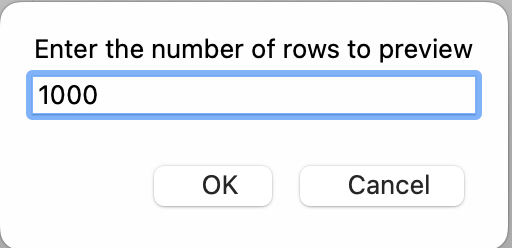
        - Leave the number of rows to preview at 1000 and press "OK". You should see a popup window similar to the one pictured below"
            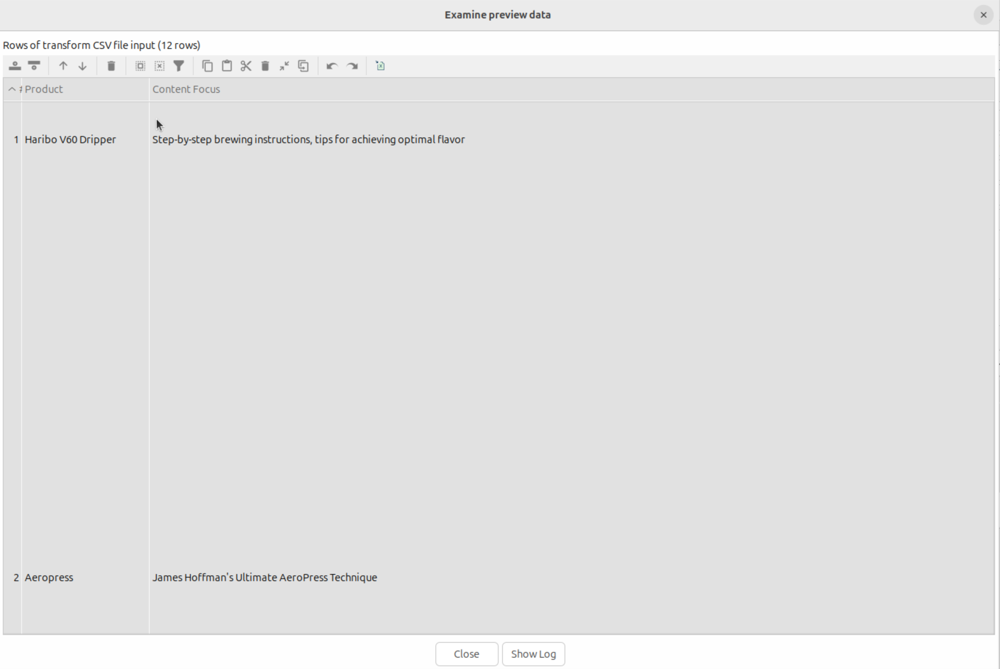

    
51. Create an “Add constants” transform and route the CSV data into it with a hop.
    
    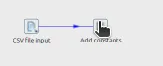
    
52. Edit the newly created “Add constants” hop and edit it. We will rename the transform to “Add data labels to CSV data” and add our column names as data labels similarly to what we performed earlier.
    
    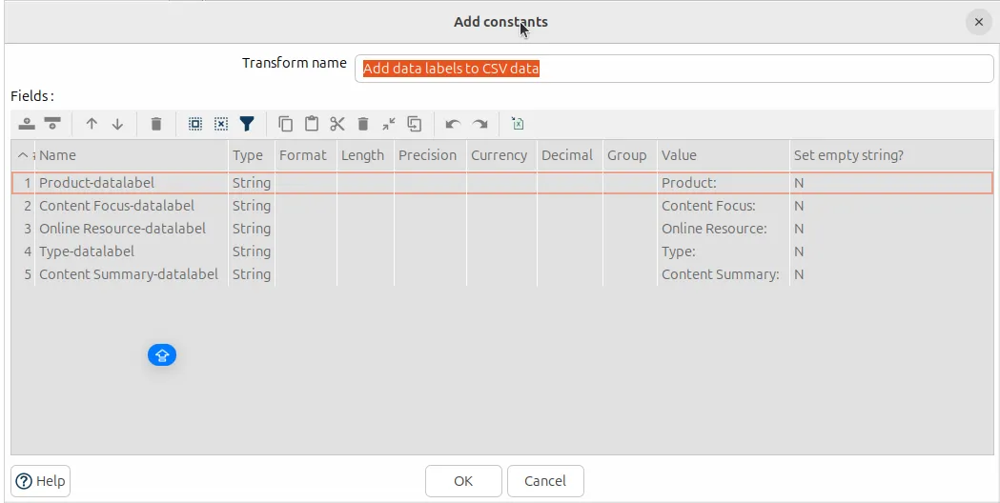
    
53. Next, add a “Concat Fields” transform and add a hop from the “Add data labels to CSV data” transform
    
    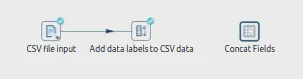
    
54. Edit the newly created “Concat Fields” transform. 
    
    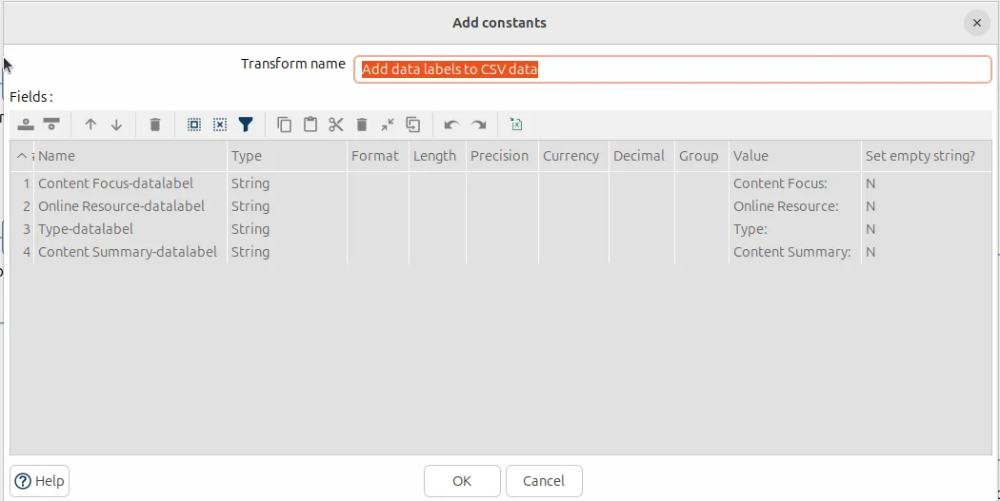
    
55. Add a “Select values” transform and add a hop from Concat Fields
    
    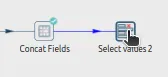
    
56. Edit the newly created “Select values 2” transform. Go the the “Meta-data” tab then select the Product and output fields. Rename the Product field to “input” and under “Binary to Normal?” select “Y”.
    
    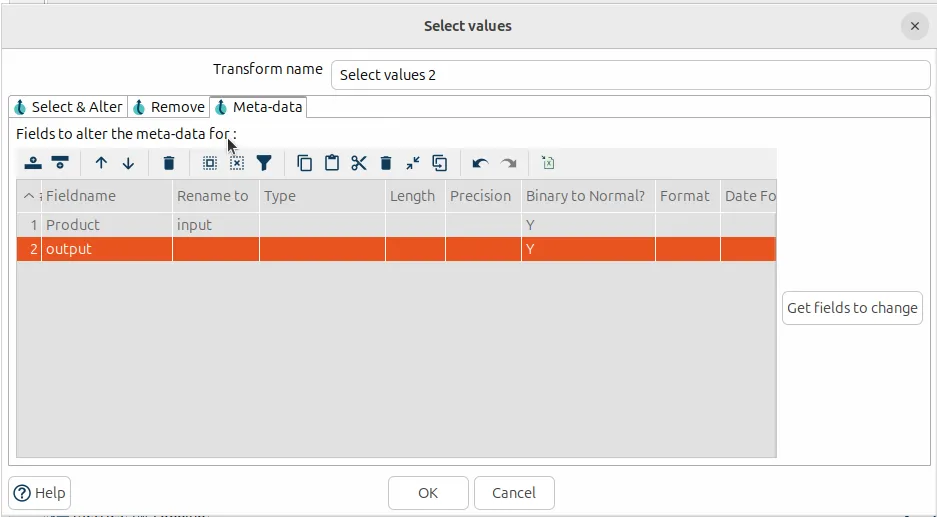
    
57. Click on a blank space on the Pipeline and add an “Append streams” transform.
    
    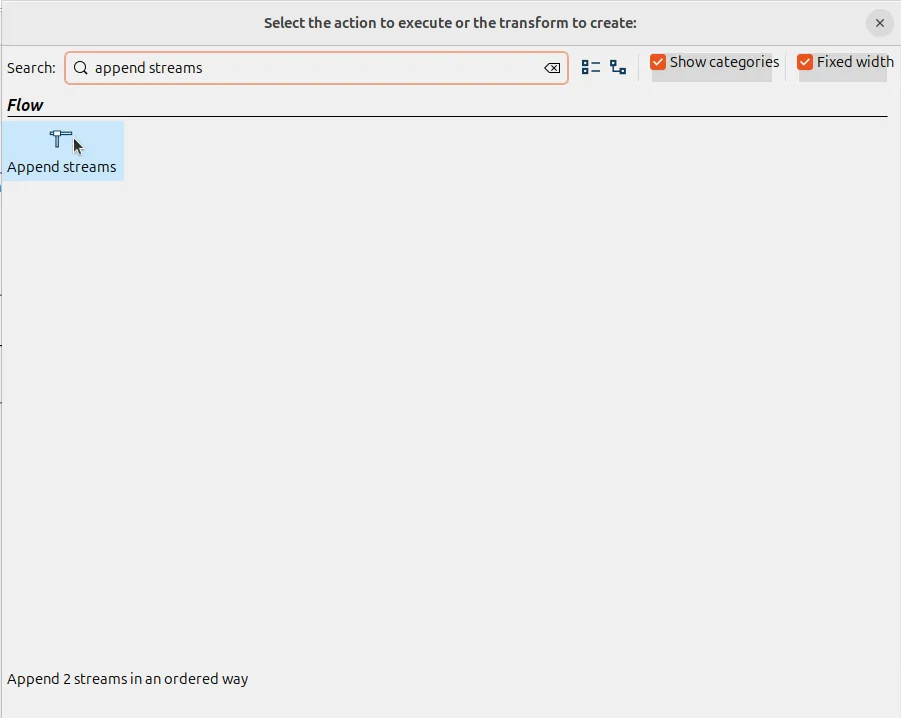
    
58. Click on the newly created “Append streams” transform and select the appropriate “Head hop” and “Tail hop”.
    
    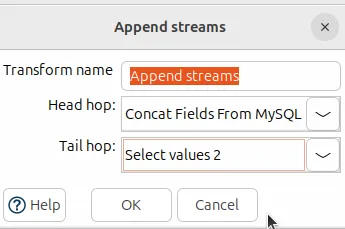

    - Afterward it should have appropriate hops going into it as shown below:
        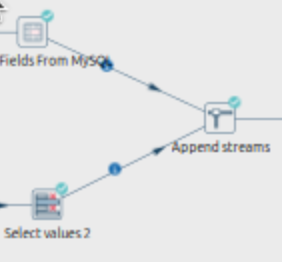
    
59. Select the “Append streams“ transform and click "Preview output". After ward press "Quick Launch" 
    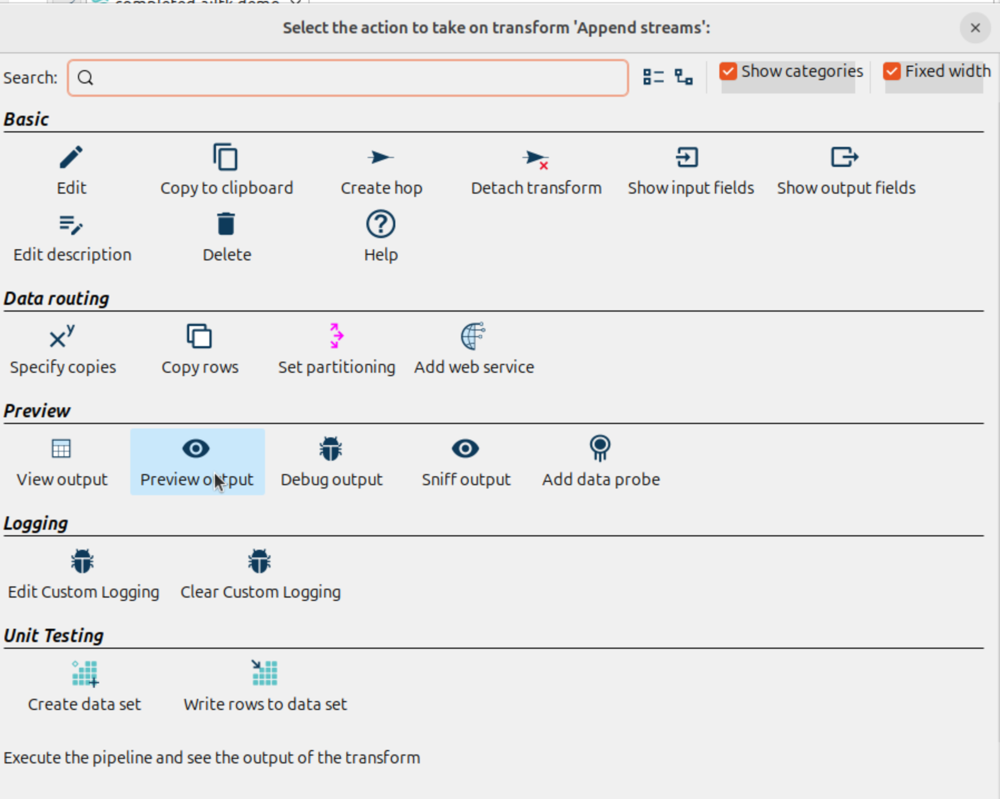
    - If you do not get a preview of the data as shown below, revisit the previous steps in this guide.
        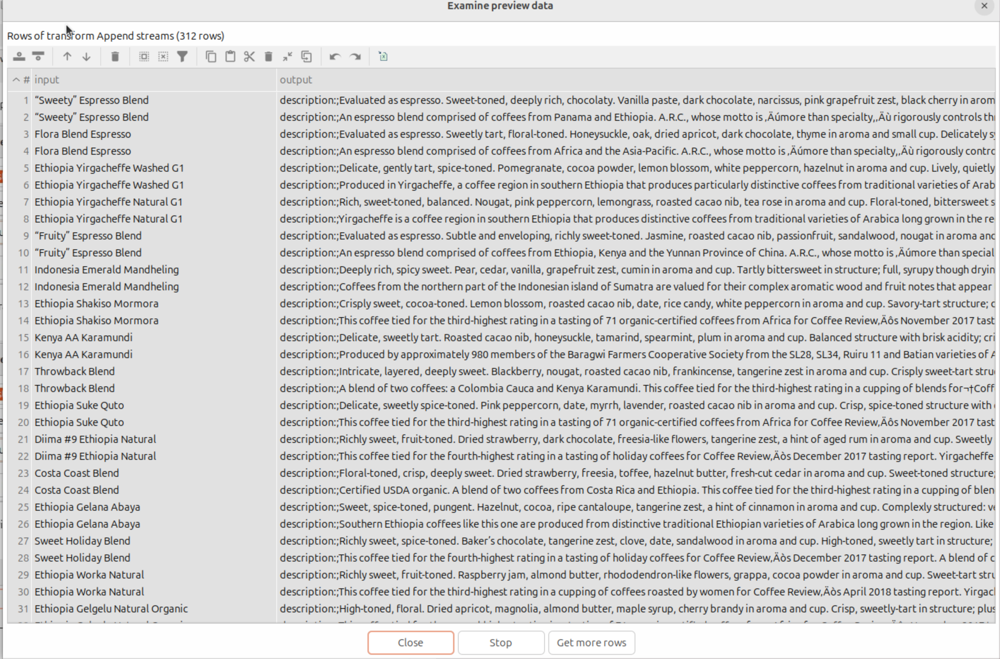
        - Afterward press "Close" 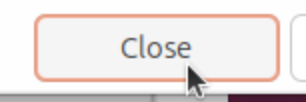

60. Click on a blank space on the Pipeline and create a “Microsoft Excel writer” transform. Create a hop form the “Append streams” transform into it.
    
    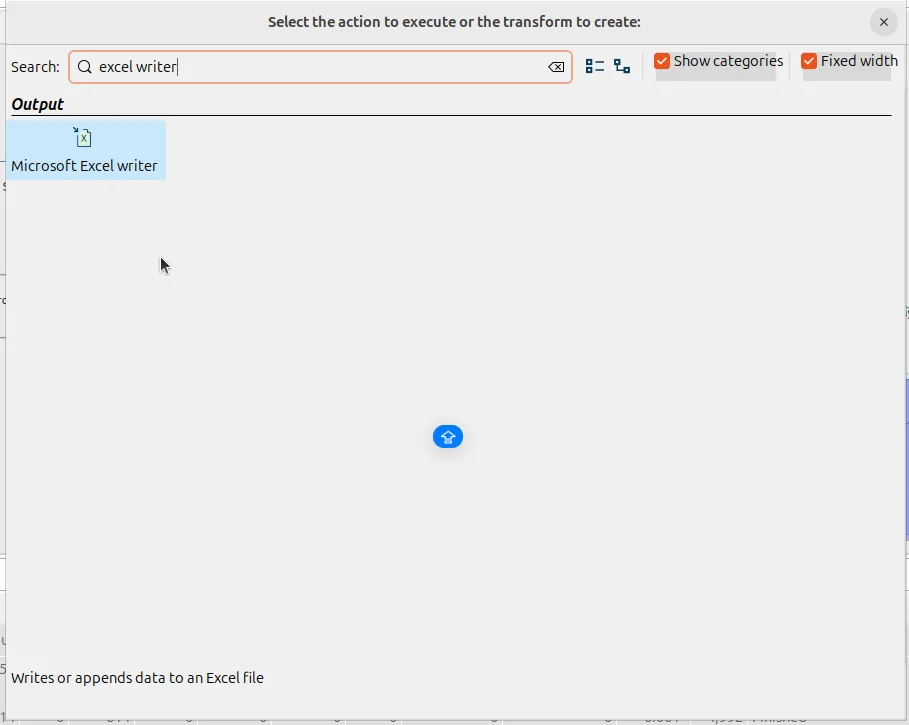
    
61. Select the “Microsoft Excel writer” transform and click "Edit".
    
    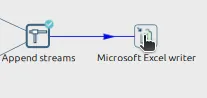
    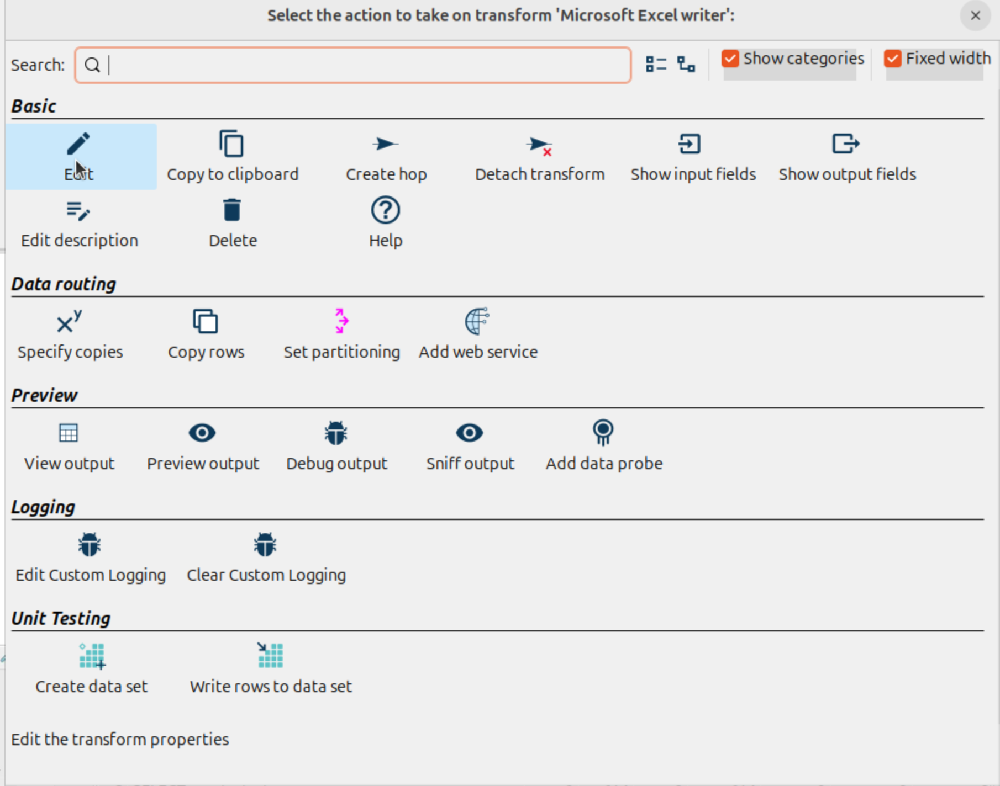
    - Name the file that the output will be saved as appropriately. The other fields may be left with their default values. By default the file will be saved in the directory of your hop install.
        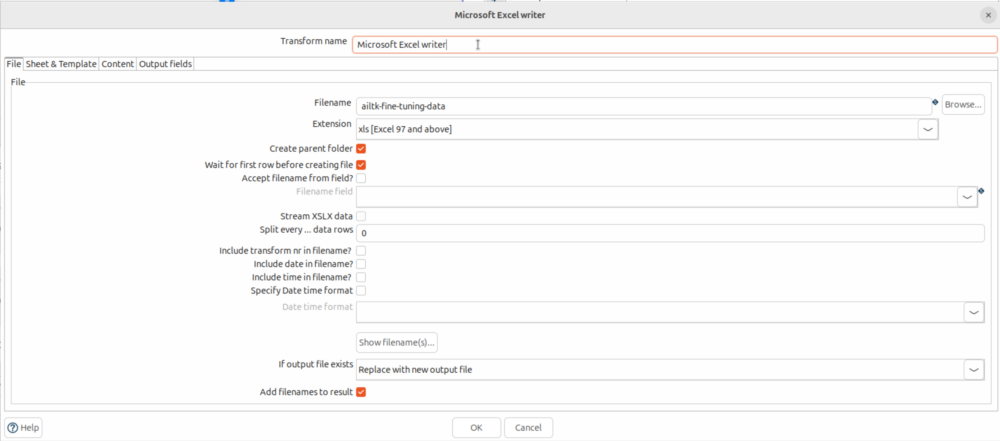
        - Press "OK" once you are done.
    - You may also preview the output of the "Microsoft Excel Writer" by selecting it once again.
        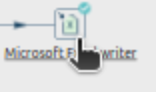
        and clicking "Preview Output"
        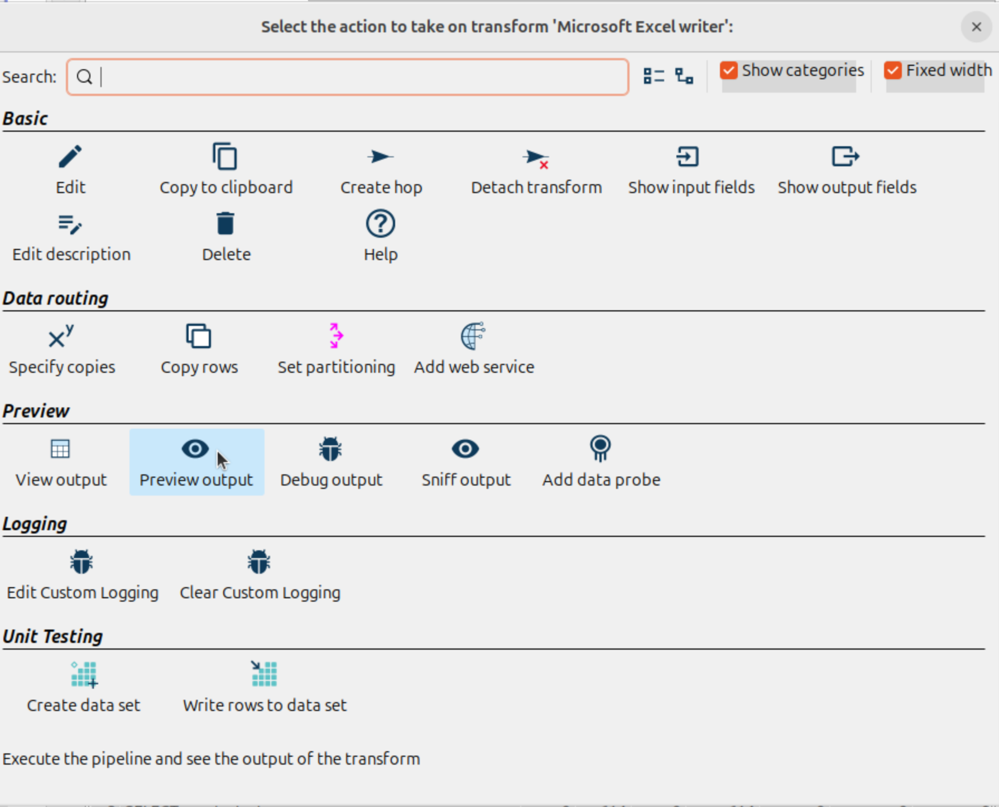
        and then "Quick Launch"
        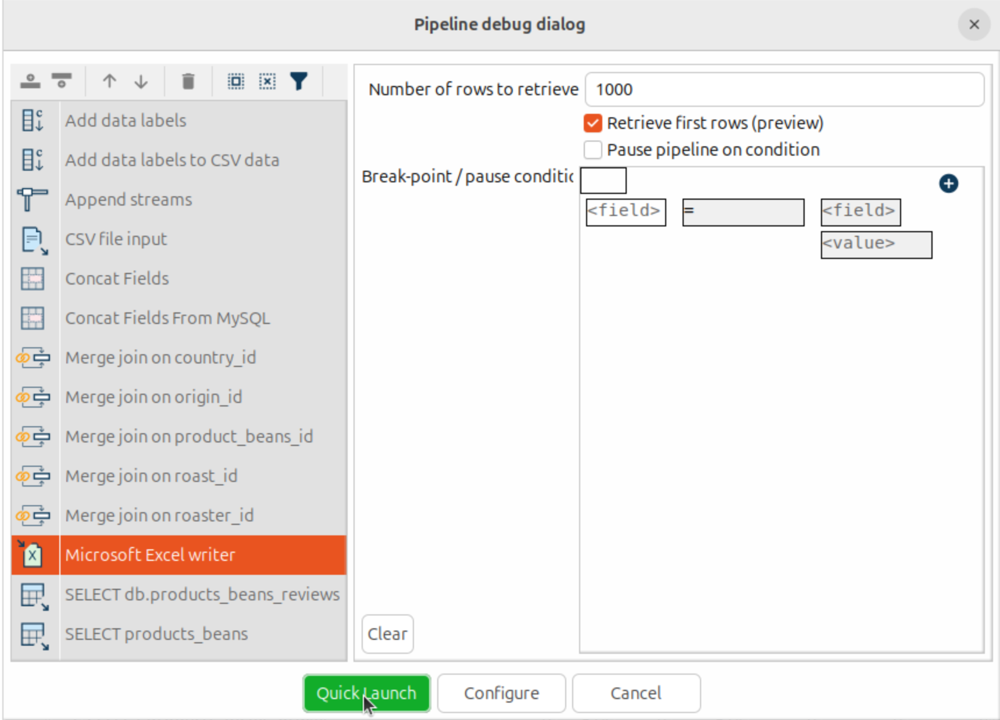
        - The preview should look similar to the sample shown below:
            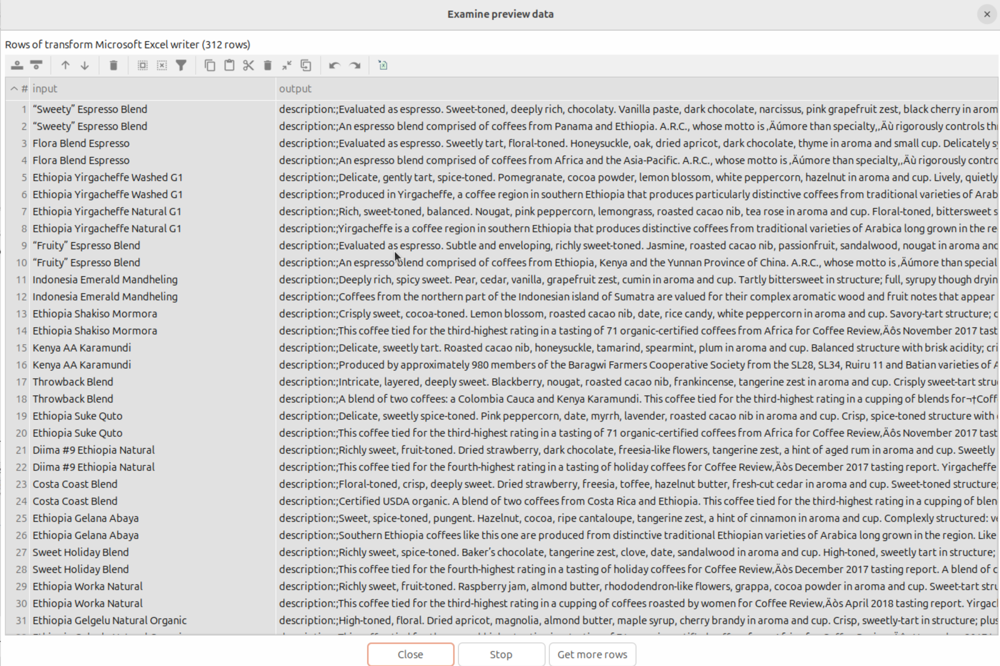
    
62. Click on the Run button shown in the screenshot below to run the Pipeline. 
    
    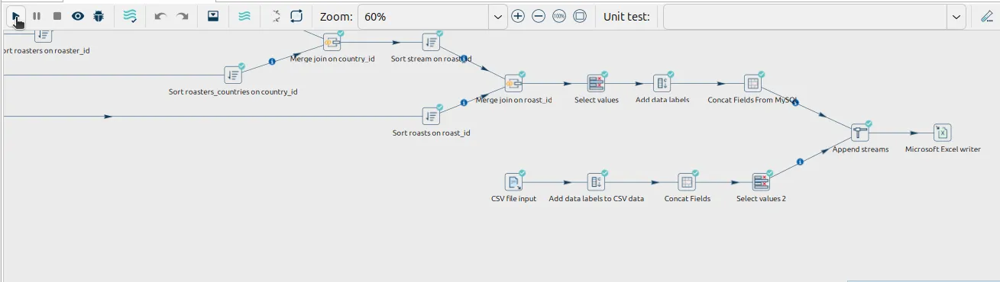
    
63. Click “Launch” in the window that pops up.
    
    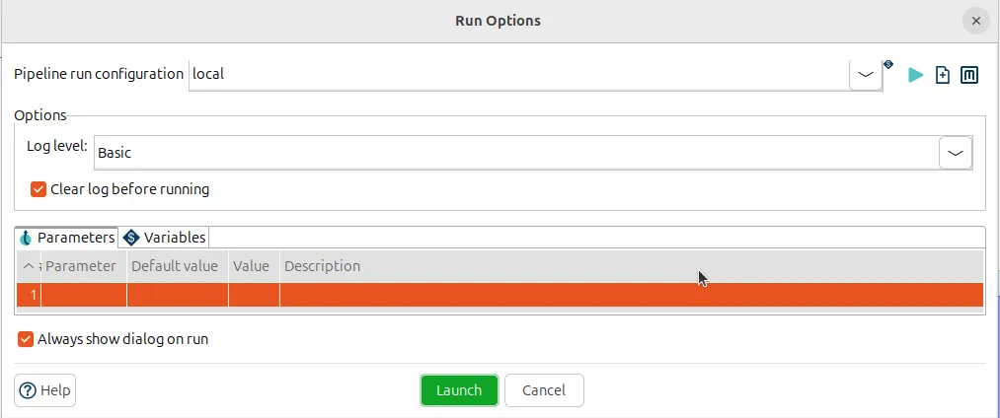
    
64. Done! Navigate to your hop directory in the file explorer (`/home/ailtk-learner/hop/` in the Virtual Machine). You should see your outputted dataset there.

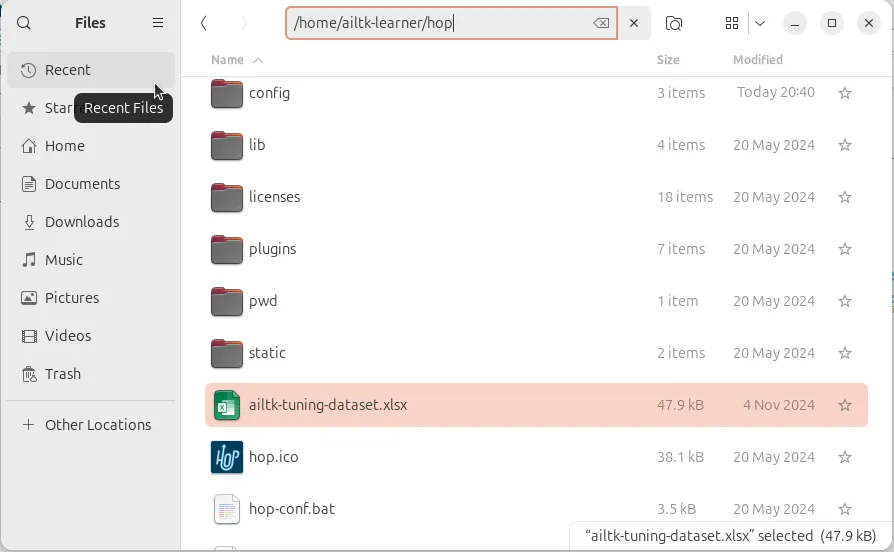

- You can view a completed Pipeline accomplished for this task here: 
    <a href="../learning-files/ailtk-solutions-pla3.ipynb" target="_blank">Opens the file manager</a>

### Self-refelction: Why do you think exploratory data analysis (EDA) is important?

In [ ]:
import ipywidgets as widgets
from IPython.display import display

# Create question label
question_label1 = widgets.Label(
    value="Type your answer here..."
)

# Create input text box
input_box1 = widgets.Textarea(
    placeholder='Type your answer here...',
    description='Answer:',
    layout=widgets.Layout(width='500px', height='100px')
)

# Create submit button
submit_button1 = widgets.Button(
    description="Submit",
    button_style='primary'  # Optional: styling
)

# Create output widget
output1 = widgets.Output()

# Define the button click event
def on_submit_click1(b):
    # Clear previous output
    output1.clear_output()
    with output1:
        print("""
    Data transformation ensures that the raw data from various sources is cleaned, 
    normalized, and structured to be usable for training and inference in AI models. 
    Challenges such as inconsistent formats, missing values, and duplicate data can 
    arise when integrating SQL and CSV sources, but tools like Apache Hop streamline 
    the process with automation and visual workflows. Clear labeling and consistent 
    structuring of data help AI models better understand relationships and patterns, 
    enhancing accuracy and interpretability. Insights like coffee bean characteristics, 
    brewing methods, and preparation guidance from the EDA will be prioritized to ensure
    the virtual agent can provide expert and personalized recommendations.
    """)

# Set the button's on-click function
submit_button1.on_click(on_submit_click1)

# Display the widgets
display(question_label1, input_box1, submit_button1, output1)


Label(value='Type your answer here...')

Textarea(value='', description='Answer:', layout=Layout(height='100px', width='500px'), placeholder='Type your…

Button(button_style='primary', description='Submit', style=ButtonStyle())

Output()

#### [ Back to Learning Instructions 3](../learning-instructions-3.ipynb)